In [45]:
# Importing necessary libraries for data processing and machine learning
import numpy as np  # For linear algebra operations
import pandas as pd  # For data processing and handling CSV file I/O
import tensorflow as tf  # For building and training deep learning models
import cv2  # OpenCV for image processing
import gc  # For garbage collection to free up memory

# Display TensorFlow version
print("TensorFlow Version:", tf.__version__)

# Garbage collection is used to manage memory by freeing up space from unused variables or objects
gc.collect()

# Updated code to list all files in the input directory (you can comment it out if not needed)
# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# TensorFlow 2.x updates: Ensure the use of Keras API directly from TensorFlow 
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam

# If you're loading a model, ensure to use `tf.keras.models.load_model` instead of older methods
# For example:
# model = tf.keras.models.load_model('path_to_model')

# Code to define your model or other functionalities follows here...


TensorFlow Version: 2.16.1


In [46]:
# Set global seed for reproducibility
tf.random.set_seed(42)

In [47]:
df = pd.read_csv('/kaggle/input/siim-isic-melanoma-classification/train.csv')
df.head()
df = df.sort_values("target", ascending = False)

In [48]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 33126 entries, 29417 to 11142
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   image_name                     33126 non-null  object 
 1   patient_id                     33126 non-null  object 
 2   sex                            33061 non-null  object 
 3   age_approx                     33058 non-null  float64
 4   anatom_site_general_challenge  32599 non-null  object 
 5   diagnosis                      33126 non-null  object 
 6   benign_malignant               33126 non-null  object 
 7   target                         33126 non-null  int64  
dtypes: float64(1), int64(1), object(6)
memory usage: 2.3+ MB


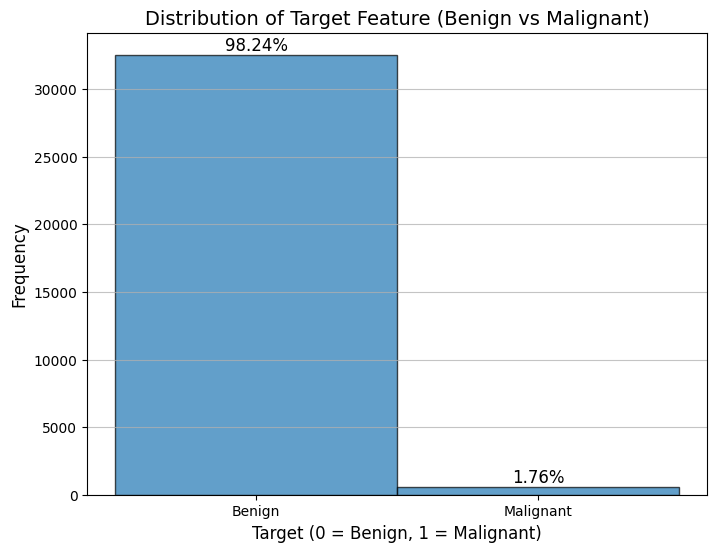

In [49]:
import matplotlib.pyplot as plt

# Plot the histogram for the target feature
plt.figure(figsize=(8, 6))
counts, bins, patches = plt.hist(df['target'], bins=2, edgecolor='black', alpha=0.7)

# Title and labels
plt.title('Distribution of Target Feature (Benign vs Malignant)', fontsize=14)
plt.xlabel('Target (0 = Benign, 1 = Malignant)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks([0.25, 0.75], ['Benign', 'Malignant'])  # Adjust x-ticks for better centering
plt.grid(axis='y', alpha=0.75)

# Calculate total number of samples
total = len(df['target'])

# Add percentages to the center of the bars
for i in range(2):
    percentage = (counts[i] / total) * 100  # Calculate percentage
    # Use (bins[i] + bins[i+1]) / 2 to find the center of the bin
    plt.text((bins[i] + bins[i+1]) / 2, counts[i], f'{percentage:.2f}%', 
             ha='center', va='bottom', fontsize=12)  # ha=center for horizontal alignment

plt.show()


In [50]:
df_1 = df.iloc[:584]
df_0 = df.iloc[584:1440]
df_0 = df_0.sample(frac = 1)
df_0.head()

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
22291,ISIC_6757540,IP_7644786,female,60.0,lower extremity,unknown,benign,0
22054,ISIC_6676883,IP_3402498,male,65.0,upper extremity,unknown,benign,0
22088,ISIC_6688054,IP_9751397,female,35.0,torso,unknown,benign,0
22529,ISIC_6831734,IP_9853347,male,55.0,torso,unknown,benign,0
22398,ISIC_6786991,IP_9450101,female,45.0,torso,unknown,benign,0


In [51]:
df_train = pd.concat([df_1,df_0])
df_train = df_train.sample(frac=1)
df_train

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
22117,ISIC_6699023,IP_6617725,female,35.0,torso,nevus,benign,0
22119,ISIC_6699854,IP_2666042,male,50.0,lower extremity,unknown,benign,0
21976,ISIC_6652978,IP_6269870,female,55.0,upper extremity,unknown,benign,0
18578,ISIC_5642824,IP_6285147,male,75.0,head/neck,melanoma,malignant,1
22664,ISIC_6876691,IP_2041319,female,60.0,torso,nevus,benign,0
...,...,...,...,...,...,...,...,...
20904,ISIC_6348638,IP_3623410,male,60.0,torso,melanoma,malignant,1
22292,ISIC_6757635,IP_8173459,female,50.0,head/neck,unknown,benign,0
21924,ISIC_6637542,IP_4879325,female,55.0,head/neck,unknown,benign,0
22386,ISIC_6784593,IP_9086201,female,40.0,torso,melanoma,malignant,1


# **Data Preprocessing**

In [52]:
def preprocessing(dataset):
    # Impute missing values using mode for the specified columns
    # Instead of using 'inplace', assign the filled columns back to the dataset directly
    dataset['sex'] = dataset['sex'].fillna(dataset['sex'].mode()[0])
    dataset['age_approx'] = dataset['age_approx'].fillna(dataset['age_approx'].mode()[0])
    dataset['anatom_site_general_challenge'] = dataset['anatom_site_general_challenge'].fillna(dataset['anatom_site_general_challenge'].mode()[0])

    # Replace categorical values with integers using a mapping dictionary
    sex_mapping = {'male': 0, 'female': 1}
    anatom_site_mapping = {
        'torso': 0,
        'lower extremity': 1,
        'upper extremity': 2,
        'head/neck': 3,
        'palms/soles': 4,  # Adjusted for logical ordering
        'oral/genital': 5  # Adjusted for logical ordering
    }

    # Apply the mappings
    dataset['sex'] = dataset['sex'].map(sex_mapping)
    dataset['anatom_site_general_challenge'] = dataset['anatom_site_general_challenge'].map(anatom_site_mapping)

    return dataset


In [53]:
df_train = preprocessing(df_train)
df_train

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
22117,ISIC_6699023,IP_6617725,1,35.0,0,nevus,benign,0
22119,ISIC_6699854,IP_2666042,0,50.0,1,unknown,benign,0
21976,ISIC_6652978,IP_6269870,1,55.0,2,unknown,benign,0
18578,ISIC_5642824,IP_6285147,0,75.0,3,melanoma,malignant,1
22664,ISIC_6876691,IP_2041319,1,60.0,0,nevus,benign,0
...,...,...,...,...,...,...,...,...
20904,ISIC_6348638,IP_3623410,0,60.0,0,melanoma,malignant,1
22292,ISIC_6757635,IP_8173459,1,50.0,3,unknown,benign,0
21924,ISIC_6637542,IP_4879325,1,55.0,3,unknown,benign,0
22386,ISIC_6784593,IP_9086201,1,40.0,0,melanoma,malignant,1


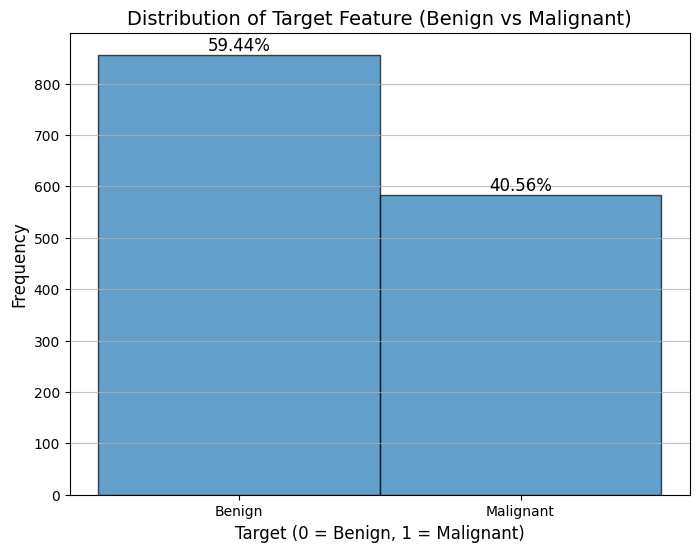

In [54]:
import matplotlib.pyplot as plt

# Plot the histogram for the target feature
plt.figure(figsize=(8, 6))
counts, bins, patches = plt.hist(df_train['target'], bins=2, edgecolor='black', alpha=0.7)

# Title and labels
plt.title('Distribution of Target Feature (Benign vs Malignant)', fontsize=14)
plt.xlabel('Target (0 = Benign, 1 = Malignant)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks([0.25, 0.75], ['Benign', 'Malignant'])  # Adjust x-ticks for better centering
plt.grid(axis='y', alpha=0.75)

# Calculate total number of samples in df_train
total = len(df_train['target'])

# Add percentages to the center of the bars
for i in range(2):
    percentage = (counts[i] / total) * 100  # Calculate percentage based on df_train
    # Use (bins[i] + bins[i+1]) / 2 to find the center of the bin
    plt.text((bins[i] + bins[i+1]) / 2, counts[i], f'{percentage:.2f}%', 
             ha='center', va='bottom', fontsize=12)  # ha=center for horizontal alignment

plt.show()


In [55]:
df_test = preprocessing(pd.read_csv('/kaggle/input/siim-isic-melanoma-classification/test.csv'))
df_test

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge
0,ISIC_0052060,IP_3579794,0,70.0,0
1,ISIC_0052349,IP_7782715,0,40.0,1
2,ISIC_0058510,IP_7960270,1,55.0,0
3,ISIC_0073313,IP_6375035,1,50.0,0
4,ISIC_0073502,IP_0589375,1,45.0,1
...,...,...,...,...,...
10977,ISIC_9992485,IP_4152479,0,40.0,0
10978,ISIC_9996992,IP_4890115,0,35.0,0
10979,ISIC_9997917,IP_2852390,0,25.0,2
10980,ISIC_9998234,IP_8861963,0,65.0,1


In [56]:
def _bytes_feature(value):
    """Returns a bytes_list from a string / byte."""
    if (isinstance(value, type(tf.constant(0)))):
        value = value.numpy() # BytesList won't unpack a string from an EagerTensor.
    return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

def _float_feature(value):
    """Returns a float_list from a float / double."""
    return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))

def _int64_feature(value):
    """Returns an int64_list from a bool / enum / int / uint."""
    return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))


In [57]:
def image_example(image_string, sex, age_approx,anatom_site_general_challenge, target, isTrain, image_name):

    if (isTrain):
        feature = {
            'sex': _int64_feature(sex),
            'age_approx': _float_feature(age_approx),
            'anatom_site_general_challenge': _int64_feature(anatom_site_general_challenge),
            'target': _int64_feature(target),
            'image_raw': _bytes_feature(image_string),
            }
    else:
        feature = {
            'image_name': _bytes_feature(image_name),
            'sex': _int64_feature(sex),
            'age_approx': _float_feature(age_approx),
            'anatom_site_general_challenge': _int64_feature(anatom_site_general_challenge),
            'image_raw': _bytes_feature(image_string),
            }
        
    return tf.train.Example(features=tf.train.Features(feature=feature))


In [58]:
import tensorflow as tf
import cv2
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import RandomOverSampler

# Step 1: Split the data into training and validation sets
train_df, valid_df = train_test_split(df_train, test_size=0.2, random_state=42, stratify=df_train['target'])

# Step 2: Oversample the training data to balance the target classes (target == 1 and target == 0)
def oversample_training_data(train_df):
    # Separate features and target
    X_train = train_df.drop(columns=['target'])
    y_train = train_df['target']
    
    # Initialize the RandomOverSampler
    ros = RandomOverSampler(sampling_strategy='auto', random_state=42)
    
    # Fit and resample the training data to balance the classes
    X_train_resampled, y_train_resampled = ros.fit_resample(X_train, y_train)
    
    # Combine the oversampled features and target back into a DataFrame
    train_df_resampled = X_train_resampled.copy()
    train_df_resampled['target'] = y_train_resampled
    
    return train_df_resampled

# Oversample the training data
train_df_oversampled = oversample_training_data(train_df)

# Step 3: Function to write the TFRecord files
def write_tfrecord(df, record_file):
    with tf.io.TFRecordWriter(record_file) as writer:
        for row in df.iterrows():
            # Read and process image
            im = cv2.imread('/kaggle/input/siim-isic-melanoma-classification/jpeg/train/' + row[1]['image_name'] + '.jpg')
            im_resize = cv2.resize(im, (300, 300))
            is_success, im_buf_arr = cv2.imencode(".jpg", im_resize)
            image_string = im_buf_arr.tobytes()

            # Create the example
            tf_example = image_example(image_string, row[1]['sex'], row[1]['age_approx'], 
                                       row[1]['anatom_site_general_challenge'], row[1]['target'], 
                                       isTrain=True, image_name=None)
            
            # Write the example to the TFRecord file
            writer.write(tf_example.SerializeToString())

# File paths for training and validation TFRecord files
train_record_file = '/kaggle/working/train.tfrecords'
valid_record_file = '/kaggle/working/valid.tfrecords'

# Step 4: Write the oversampled training data to a TFRecord file
write_tfrecord(train_df_oversampled, train_record_file)

# Step 5: Write the validation data to a separate TFRecord file (no oversampling for validation)
write_tfrecord(valid_df, valid_record_file)

print("TFRecords for oversampled training and validation have been saved.")


TFRecords for oversampled training and validation have been saved.


In [59]:
BATCH_SIZE = 16
SHUFFLE_SIZE = 1440
STEPS_PER_EPOCH = int(len(df_train.index)/BATCH_SIZE)

In [60]:
def _parse_function_train(proto):
    keys_to_features = {
        'image_raw': tf.io.FixedLenFeature([], tf.string),
        'target': tf.io.FixedLenFeature([], tf.int64),
        'sex': tf.io.FixedLenFeature([], tf.int64),
        'age_approx': tf.io.FixedLenFeature([], tf.float32),
        'anatom_site_general_challenge': tf.io.FixedLenFeature([], tf.int64)
    }
    
    # Load one example
    parsed_features = tf.io.parse_single_example(proto, keys_to_features)

    image_shape = tf.stack([300, 300, 3])

    # Decode image
    parsed_features['image_raw'] = tf.io.decode_jpeg(parsed_features['image_raw'], 3)
    parsed_features['image_raw'] = tf.reshape(parsed_features['image_raw'], image_shape)
    
    # Apply data augmentation
    parsed_features['image_raw'] = tf.image.random_brightness(parsed_features['image_raw'], 0.35)
    parsed_features['image_raw'] = tf.image.random_contrast(parsed_features['image_raw'], 0.1, 0.36)
    parsed_features['image_raw'] = tf.image.random_flip_left_right(parsed_features['image_raw'])
    parsed_features['image_raw'] = tf.image.random_flip_up_down(parsed_features['image_raw'])

    # Return tuple of inputs (image, metadata) and target
    inputs = (parsed_features['image_raw'], 
              parsed_features['sex'], 
              parsed_features['age_approx'], 
              parsed_features['anatom_site_general_challenge'])
    
    return inputs, parsed_features['target']


In [61]:
def dataset_fetch_train(filenames, isTrain):
    dataset = tf.data.TFRecordDataset(filenames)
    
    # Repeat and shuffle only for training data
    if isTrain:
        dataset = dataset.shuffle(SHUFFLE_SIZE, seed=42)
    
    # Parse the dataset
    dataset = dataset.map(_parse_function_train, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    
    # Batch and prefetch the dataset
    dataset = dataset.batch(BATCH_SIZE)
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)
    
    return dataset


In [62]:
# from PIL import Image
training_dataset = dataset_fetch_train('/kaggle/working/train.tfrecords',True)
# training_dataset = training_dataset.repeat(-1)
training_dataset


<_PrefetchDataset element_spec=((TensorSpec(shape=(None, 300, 300, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None), TensorSpec(shape=(None,), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None)), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [63]:
def _parse_function_val(proto):
    keys_to_features = {
        'image_raw': tf.io.FixedLenFeature([], tf.string),
        'target': tf.io.FixedLenFeature([], tf.int64),
        'sex': tf.io.FixedLenFeature([], tf.int64),
        'age_approx': tf.io.FixedLenFeature([], tf.float32),
        'anatom_site_general_challenge': tf.io.FixedLenFeature([], tf.int64)
    }
    
    # Load one example
    parsed_features = tf.io.parse_single_example(proto, keys_to_features)

    image_shape = tf.stack([300, 300, 3])

    # Decode and reshape image
    parsed_features['image_raw'] = tf.io.decode_jpeg(parsed_features['image_raw'], 3)
    parsed_features['image_raw'] = tf.reshape(parsed_features['image_raw'], image_shape)
    
    # Return tuple of inputs (image, metadata) and target
    inputs = (parsed_features['image_raw'], 
              parsed_features['sex'], 
              parsed_features['age_approx'], 
              parsed_features['anatom_site_general_challenge'])
    
    return inputs, parsed_features['target']


In [64]:
def dataset_fetch_val(filenames):
    dataset = tf.data.TFRecordDataset(filenames)
    
    # Parse the dataset without shuffling
    dataset = dataset.map(_parse_function_val, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    
    # Batch and prefetch the dataset
    dataset = dataset.batch(BATCH_SIZE)
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)
    
    return dataset


In [65]:
# from PIL import Image
validation_dataset = dataset_fetch_val('/kaggle/working/valid.tfrecords')

validation_dataset


<_PrefetchDataset element_spec=((TensorSpec(shape=(None, 300, 300, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None), TensorSpec(shape=(None,), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int64, name=None)), TensorSpec(shape=(None,), dtype=tf.int64, name=None))>

In [66]:
# def fetch_data(iterator):
# #     image,sex,age,site,target = iterator.get_next()
#     while True:
#         image,sex,age,site,target = iterator.get_next()
#         yield ([image,sex,age,site],target)

In [67]:
# iterator = iter(training_dataset)
# training_dataset_final = fetch_data(iterator)

# print(training_dataset_final)

In [68]:
# iterator = iter(validation_dataset)
# validation_dataset_final = fetch_data(iterator)

# print(validation_dataset_final)

# **Multi-Input Deep Learning Model with Xception Backbone for Image and Metadata Fusion**

In [69]:
# Input layers
image_input = tf.keras.layers.Input(shape=(300, 300, 3))
age_input = tf.keras.layers.Input(shape=(1,))
gender_input = tf.keras.layers.Input(shape=(1,))
site_input = tf.keras.layers.Input(shape=(1,))

# Xception model without the top
base_model = tf.keras.applications.Xception(weights='imagenet', include_top=False, input_tensor=image_input)

# Additional layers
x1 = base_model.output
x1 = tf.keras.layers.MaxPooling2D((2, 2))(x1)
x1 = tf.keras.layers.Flatten()(x1)
x1 = tf.keras.layers.Dense(128, activation='relu')(x1)
x1 = tf.keras.layers.Dropout(0.2)(x1)
out1 = tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2())(x1)

# Metadata input layers (age, gender, site)
x2 = tf.keras.layers.Dense(64, activation='relu')(age_input)
x2 = tf.keras.layers.Dropout(0.2)(x2)
out2 = tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2())(x2)

x3 = tf.keras.layers.Dense(64, activation='relu')(gender_input)
x3 = tf.keras.layers.Dropout(0.2)(x3)
out3 = tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2())(x3)

x4 = tf.keras.layers.Dense(64, activation='relu')(site_input)
x4 = tf.keras.layers.Dropout(0.2)(x4)
out4 = tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2())(x4)

# Concatenate all outputs
merged = tf.keras.layers.concatenate([out1, out2, out3, out4])

# Final dense layers
op = tf.keras.layers.Dense(64, activation='relu')(merged)
op = tf.keras.layers.Dropout(0.3)(op)
op = tf.keras.layers.Dense(16, activation='relu', kernel_regularizer=tf.keras.regularizers.l2())(op)
output_final = tf.keras.layers.Dense(1, activation='sigmoid')(op)

# Create the full model
model = tf.keras.models.Model(inputs=[image_input, age_input, gender_input, site_input], outputs=output_final)


In [70]:
model.compile( optimizer=tf.keras.optimizers.Adamax(),
    loss='binary_crossentropy',
    metrics=['accuracy'],)
#     target_tensors = [image_raw])

In [71]:
model.summary()

Model: "functional_51"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 300, 300,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, 149, 149,  │        864 │ input_layer_4[0]… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, 149, 149,  │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, 149, 149,  │          0 │ block1_conv1_bn[… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, 147, 147,  │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, 147, 147,  │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, 147, 147,  │          0 │ block1_conv2_bn[… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, 147, 147,  │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, 147, 147,  │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, 147, 147,  │          0 │ block2_sepconv1_… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, 147, 147,  │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, 147, 147,  │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 74, 74,    │      8,192 │ block1_conv2_act… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, 74, 74,    │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 74, 74,    │        512 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_12 (Add)        │ (None, 74, 74,    │          0 │ block2_pool[0][0… │
│                     │ 128)              │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, 74, 74,    │          0 │ add_12[0][0]    

 Total params: 27,435,273 (104.66 MB)

 Trainable params: 27,380,745 (104.45 MB)

 Non-trainable params: 54,528 (213.00 KB)

In [72]:
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np

# Step 1: Define EarlyStopping callback
early_stopping = EarlyStopping(
    monitor='val_accuracy',    # Monitoring validation accuracy for stopping
    patience=10,                # Stop if there's no improvement for 5 epochs
    restore_best_weights=True, # Restore best model weights
    verbose=1                  # Display message when stopping
)

In [73]:
# Apply repeat() to avoid running out of data
training_dataset = dataset_fetch_train('/kaggle/working/train.tfrecords', True).repeat()
validation_dataset = dataset_fetch_val('/kaggle/working/valid.tfrecords').repeat()

In [74]:

# Check the validation steps and ensure the dataset is properly sized
validation_steps = len(valid_df) // BATCH_SIZE  # or set to None for automatic inference

# Fit the model with EarlyStopping callback
history = model.fit(
    training_dataset,  # Structured training dataset
    validation_data=validation_dataset,  # Structured validation dataset
    epochs=50,  # Max epochs
    steps_per_epoch=STEPS_PER_EPOCH,
    validation_steps=validation_steps,  # Automatically inferred steps
    callbacks=[early_stopping]  # EarlyStopping callback
)


Epoch 1/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 96s 533ms/step - accuracy: 0.5354 - loss: 2.8922 - val_accuracy: 0.7674 - val_loss: 1.7695
Epoch 2/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 23s 251ms/step - accuracy: 0.6502 - loss: 1.8014 - val_accuracy: 0.7847 - val_loss: 1.3832
Epoch 3/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 22s 249ms/step - accuracy: 0.7517 - loss: 1.3758 - val_accuracy: 0.7743 - val_loss: 1.2189
Epoch 4/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 23s 251ms/step - accuracy: 0.7675 - loss: 1.2227 - val_accuracy: 0.7882 - val_loss: 1.1542
Epoch 5/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 23s 250ms/step - accuracy: 0.7900 - loss: 1.1398 - val_accuracy: 0.7708 - val_loss: 1.1542
Epoch 6/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 23s 250ms/step - accuracy: 0.8299 - loss: 1.0195 - val_accuracy: 0.6493 - val_loss: 1.6514
Epoch 7/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 23s 250ms/step - accuracy: 0.8206 - loss: 0.9750 - val_accuracy: 0.7083 - val_loss: 1.5647
Epoch 8/50
90/90 ━━━━━━━━━━━━━━━━━━━━ 23s 251ms/step - accuracy: 0.8431 - loss: 0.9080 - val_accu

# **Evaluation Matrices**

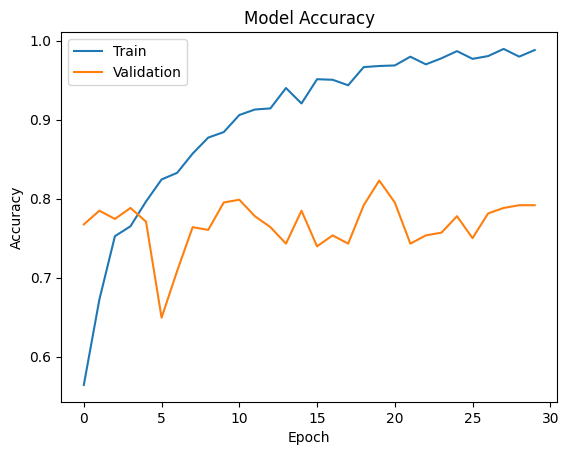

In [75]:
# Step 3: Plot training & validation accuracy values
def plot_accuracy(history):
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

# Plot accuracy
plot_accuracy(history)

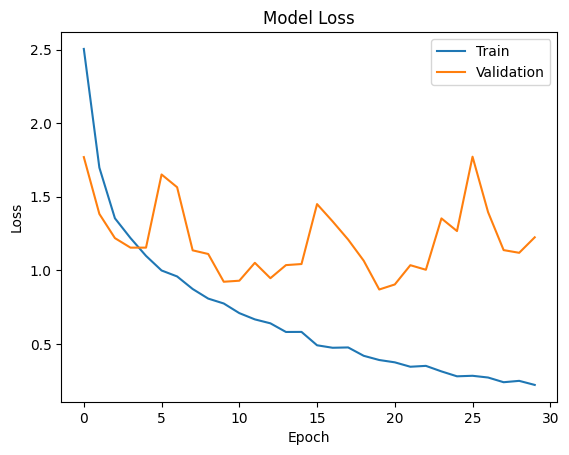

In [76]:
# Step 4: Plot training & validation loss values
def plot_loss(history):
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')
    plt.show()

# Plot loss
plot_loss(history)

In [77]:
# Save the entire model
model.save('/kaggle/working/melanoma_detection_model.h5')  # Save the model as an HDF5 file (or you can specify other file paths)

print("Model saved successfully!")

Model saved successfully!


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


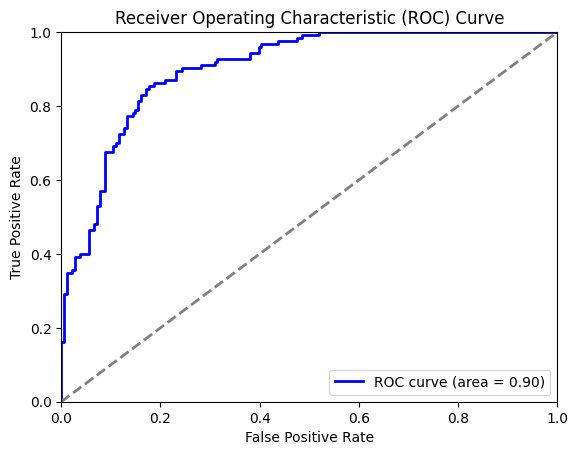

Optimal threshold based on ROC curve: 0.59


In [78]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc

# Initialize lists to store true labels and predicted probabilities
y_true = []
y_pred_proba = []

# Iterate through the validation dataset to get predicted probabilities
for step, (inputs, y) in enumerate(validation_dataset):
    predictions = model.predict(inputs)  # Get model predictions (probabilities)
    
    y_true.extend(y.numpy())  # Ground truth labels
    y_pred_proba.extend(predictions.flatten())  # Get the predicted probabilities
    
    # Optional: Stop after a certain number of steps if necessary
    if step >= len(valid_df) // BATCH_SIZE:
        break

# Convert lists to arrays for confusion matrix and ROC generation
y_true = np.array(y_true).astype(int)
y_pred_proba = np.array(y_pred_proba)

# Step 1: Generate ROC curve
fpr, tpr, thresholds = roc_curve(y_true, y_pred_proba)
roc_auc = auc(fpr, tpr)

# Step 2: Plot the ROC curve
plt.figure()
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')  # Reference line
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

# Step 3: Determine the optimal threshold (you can define it manually based on the curve)
optimal_idx = np.argmax(tpr - fpr)  # This is one common approach for choosing a threshold
optimal_threshold = thresholds[optimal_idx]
print(f'Optimal threshold based on ROC curve: {optimal_threshold:.2f}')


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


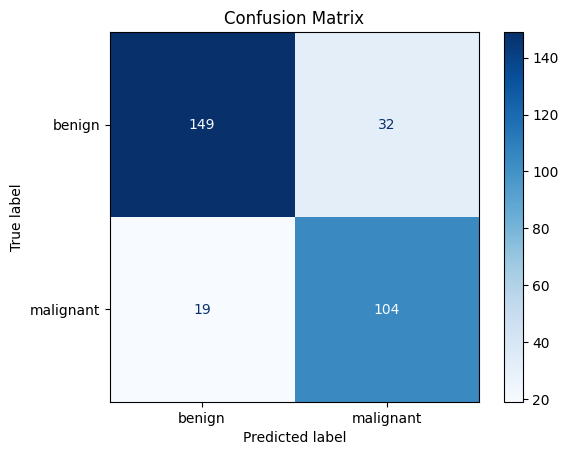

In [79]:
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Initialize lists to store true labels and predictions
y_true = []
y_pred = []

# Define your custom threshold (e.g., 0.65)
custom_threshold = round(optimal_threshold, 2)

# Iterate through the validation dataset to get predictions
for step, (inputs, y) in enumerate(validation_dataset):  # Directly use validation_dataset
    predictions = model.predict(inputs)  # Get model predictions
    
    # Apply custom threshold instead of rounding
    y_true.extend(y.numpy())  # Ground truth labels
    y_pred.extend((predictions >= custom_threshold).astype(int).flatten())  # Apply threshold
    
    # Optional: Stop after a certain number of steps if necessary
    if step >= len(valid_df) // BATCH_SIZE:
        break

# Convert lists to arrays for confusion matrix generation
y_true = np.array(y_true).astype(int)
y_pred = np.array(y_pred).astype(int)

# Step 5: Generate and display confusion matrix
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['benign', 'malignant'])
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()


In [80]:
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
import pandas as pd

# Calculate precision, recall, f1-score, and accuracy
precision = precision_score(y_true, y_pred)
recall = recall_score(y_true, y_pred)
f1 = f1_score(y_true, y_pred)
accuracy = accuracy_score(y_true, y_pred)

# Create a pandas DataFrame to display the metrics
metrics_data = {
    'Metric': ['Precision', 'Recall', 'F1 Score', 'Accuracy'],
    'Score': [precision, recall, f1, accuracy]
}

metrics_df = pd.DataFrame(metrics_data)

# Display the DataFrame using Pandas
print(metrics_df)


      Metric     Score
0  Precision  0.764706
1     Recall  0.845528
2   F1 Score  0.803089
3   Accuracy  0.832237


In [81]:
from IPython.display import display
display(metrics_df)


,Metric,Score
0,Precision,0.764706
1,Recall,0.845528
2,F1 Score,0.803089
3,Accuracy,0.832237


In [82]:
from sklearn.metrics import classification_report

# Generate a classification report
report = classification_report(y_true, y_pred, target_names=['benign', 'malignant'])

# Print the classification report
print(report)


              precision    recall  f1-score   support

      benign       0.89      0.82      0.85       181
   malignant       0.76      0.85      0.80       123

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.84      0.83      0.83       304



In [83]:
gc.collect()

57442

In [84]:
# predictions_list = np.array([], dtype = 'float32')
# print(predictions_list)
# for row in df_test.iterrows():
#     im_test = cv2.imread('/kaggle/input/siim-isic-melanoma-classification/jpeg/test/' + row[1]['image_name'] + '.jpg')
#     im_resize = np.reshape(cv2.resize(im_test, (300, 300)), (1,300,300,3))
#     predictions_list = np.append(predictions_list,model.predict([im_resize, np.reshape(row[1]['sex'],(1)), 
#                                                                                 np.reshape(row[1]['age_approx'],(1)), 
#                                                                                     np.reshape(row[1]['anatom_site_general_challenge'],(1))])[0])#[1])

#     print(predictions_list.shape, end = "\r")


In [85]:
# Check the input shapes of the model
for input_layer in model.inputs:
    print(f"Input Layer Name: {input_layer.name}, Input Shape: {input_layer.shape}")



Input Layer Name: keras_tensor_154, Input Shape: (None, 300, 300, 3)
Input Layer Name: keras_tensor_155, Input Shape: (None, 1)
Input Layer Name: keras_tensor_156, Input Shape: (None, 1)
Input Layer Name: keras_tensor_157, Input Shape: (None, 1)


# **XAI & Model Predictions & Sample Submission**

In [86]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from scipy.ndimage import zoom
import pandas as pd

In [87]:
# Function to generate the Grad-CAM heatmap
def generate_gradcam_heatmap(input_model, image, metadata, last_conv_layer_name='block14_sepconv2_act'):
    preds = input_model.predict([image] + metadata)
    class_idx = np.argmax(preds[0])  # Get the predicted class
    last_conv_layer = input_model.get_layer(last_conv_layer_name).output
    
    grad_model = tf.keras.models.Model(
        inputs=input_model.inputs, 
        outputs=[last_conv_layer, input_model.output]
    )
    
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model([image] + metadata)
        class_output = predictions[:, class_idx]

    # Calculate gradients with respect to the last conv layer
    grads = tape.gradient(class_output, conv_outputs)
    
    # Pool the gradients across the spatial dimensions
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    # Multiply the activations with the pooled gradients
    conv_outputs = conv_outputs[0]
    conv_outputs = conv_outputs @ pooled_grads[..., tf.newaxis]
    
    heatmap = tf.maximum(conv_outputs, 0)  # Apply ReLU
    
    # Normalize the heatmap to [0, 1]
    if tf.reduce_max(heatmap) != 0:
        heatmap /= tf.reduce_max(heatmap)
    
    return heatmap.numpy()

In [88]:
# Function to generate Grad-CAM++ heatmap
def generate_gradcam_plus(input_model, image, metadata, last_conv_layer_name='block14_sepconv2_act', H=300, W=300):
    preds = input_model.predict([image] + metadata)
    cls = np.argmax(preds[0])  # Get the predicted class

    last_conv_layer = input_model.get_layer(last_conv_layer_name).output
    grad_model = tf.keras.models.Model(inputs=input_model.inputs, outputs=[last_conv_layer, input_model.output])

    with tf.GradientTape(persistent=True) as tape:
        conv_outputs, predictions = grad_model([image] + metadata)
        class_output = predictions[:, cls]

        grads = tape.gradient(class_output, conv_outputs)
        second_grads = grads * grads
        third_grads = second_grads * grads

    global_sum = np.sum(conv_outputs[0], axis=(0, 1))

    # Calculate alphas (spatial importance)
    alpha_num = second_grads[0]
    alpha_denom = 2.0 * second_grads[0] + third_grads[0] * global_sum
    alpha_denom = np.where(alpha_denom != 0.0, alpha_denom, np.ones(alpha_denom.shape))  # Avoid division by zero
    alphas = alpha_num / alpha_denom

    # Calculate the weights and normalize alphas
    weights = np.maximum(grads[0], 0.0)
    alpha_normalization_constant = np.sum(alphas, axis=(0, 1), keepdims=True)  # Adjust shape for normalization
    alphas /= alpha_normalization_constant  # Correct reshaping based on the number of channels

    # Combine alphas and weights to get the Grad-CAM++ heatmap
    deep_linearization_weights = np.sum(alphas * weights, axis=(0, 1))  # Weighted sum
    grad_CAM_map = np.sum(deep_linearization_weights * conv_outputs[0], axis=2)

    # Ensure the heatmap is at least 3D before resizing
    cam = np.expand_dims(grad_CAM_map, axis=-1)  # Add a channel dimension if it's missing
    cam = tf.image.resize(cam, [H, W])  # Resize to original image size
    cam = cam / np.max(cam)  # Normalize the heatmap

    return cam.numpy()

In [89]:
# Function to overlay the heatmap on the image
def overlay_heatmap(image, heatmap, alpha=0.4):
    heatmap_resized = cv2.resize(heatmap, (image.shape[1], image.shape[0]))  # Resize heatmap to image size
    heatmap_resized = np.uint8(255 * heatmap_resized)  # Scale the heatmap to 0-255 for visualization
    
    # Apply colormap
    heatmap_colormap = cv2.applyColorMap(heatmap_resized, cv2.COLORMAP_JET)
    
    # Superimpose the heatmap on the original image
    overlayed_img = cv2.addWeighted(image, 1.0 - alpha, heatmap_colormap, alpha, 0)
    
    return overlayed_img

Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


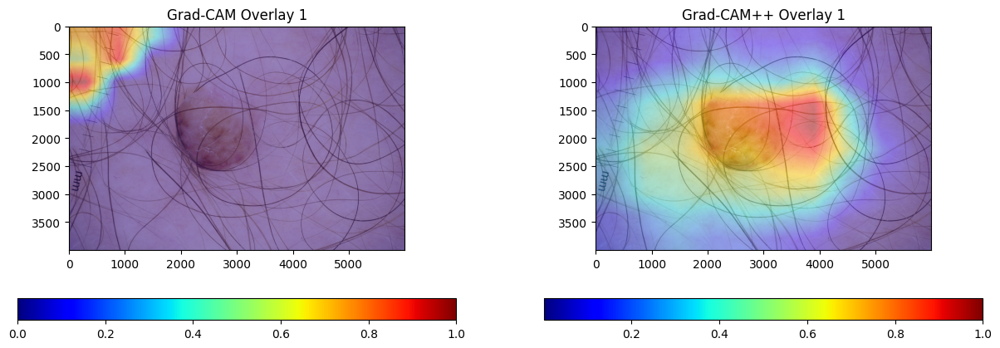

Prediction for image 1: [0.00345233]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


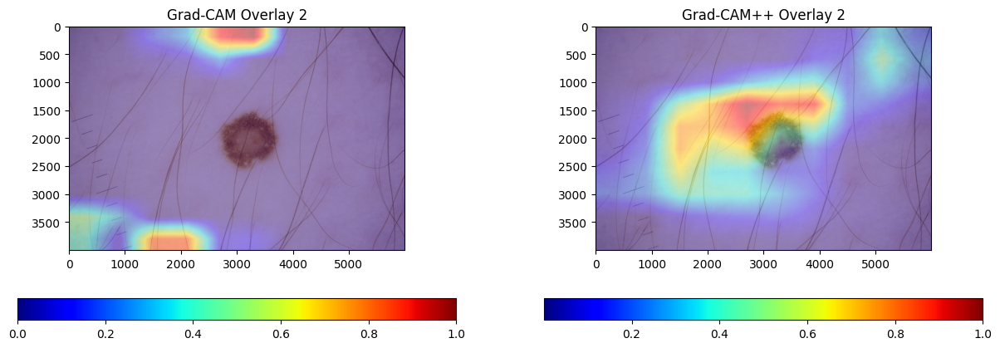

Prediction for image 2: [0.02279364]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


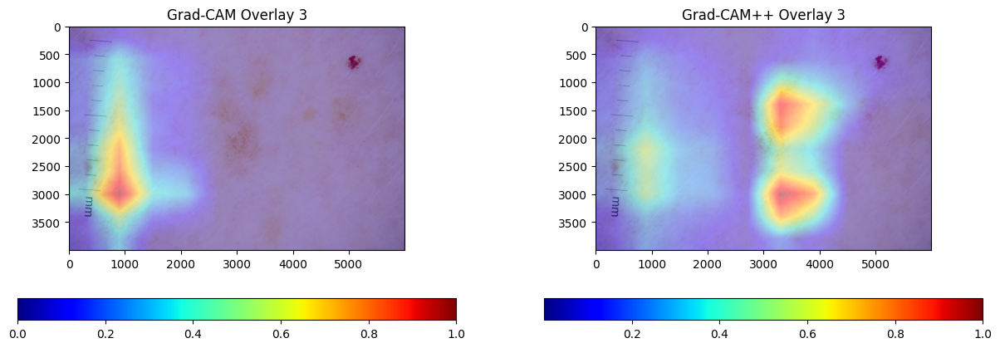

Prediction for image 3: [0.01678463]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


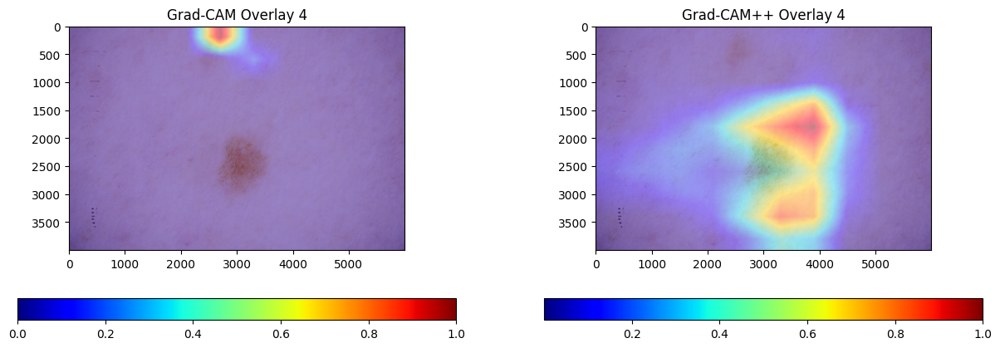

Prediction for image 4: [7.946817e-06]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


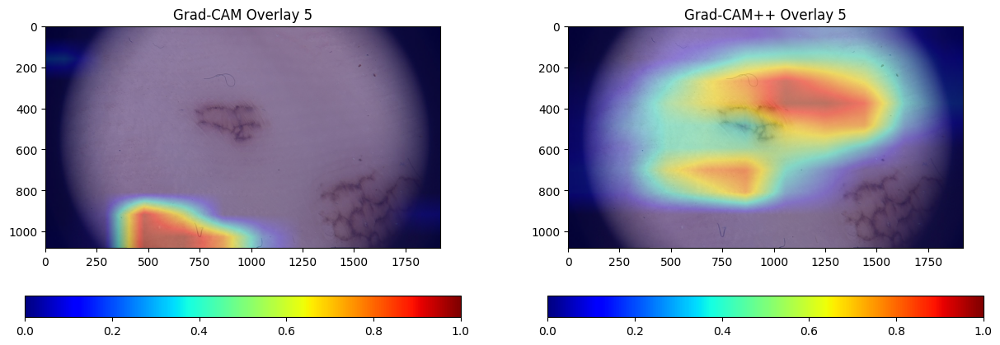

Prediction for image 5: [0.00078922]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


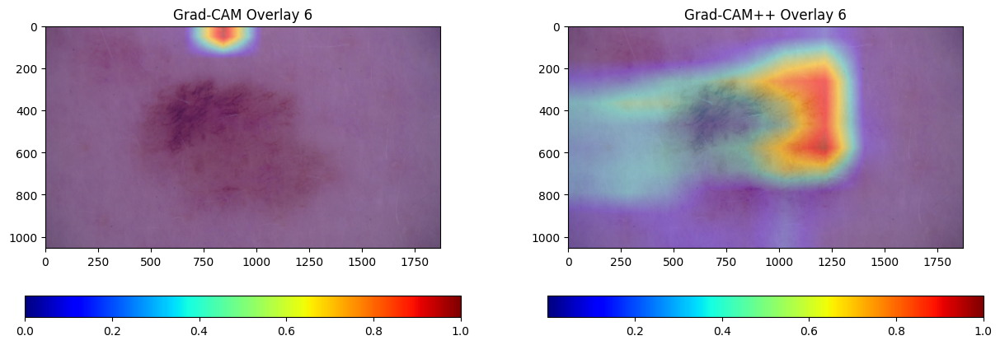

Prediction for image 6: [0.02219347]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


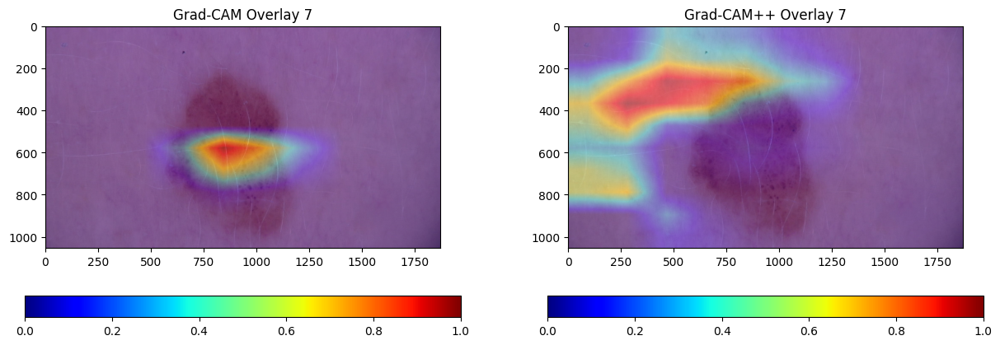

Prediction for image 7: [0.2847339]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


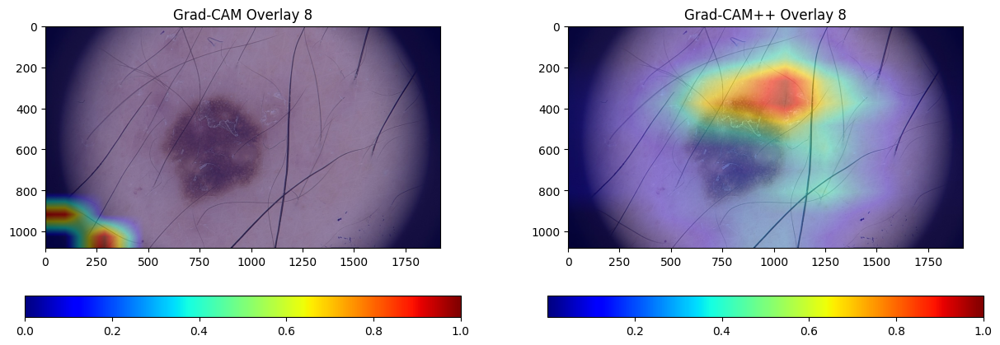

Prediction for image 8: [0.05952502]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


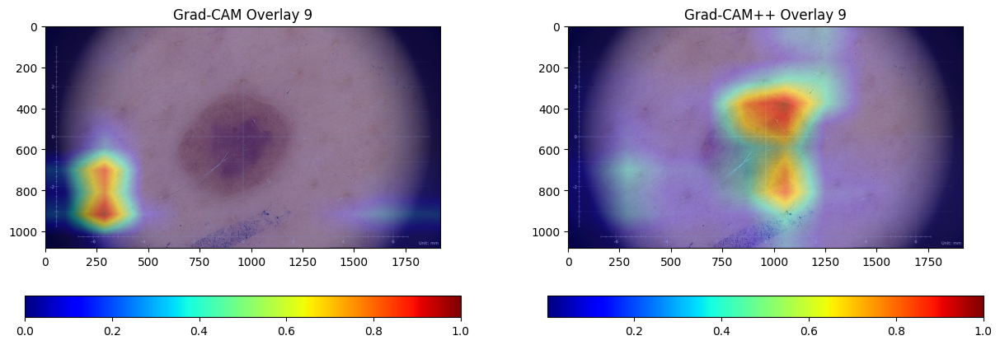

Prediction for image 9: [0.08233511]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


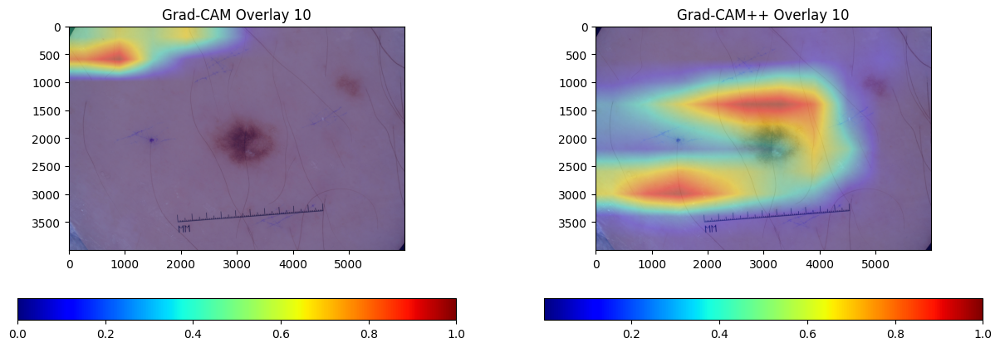

Prediction for image 10: [0.00321374]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


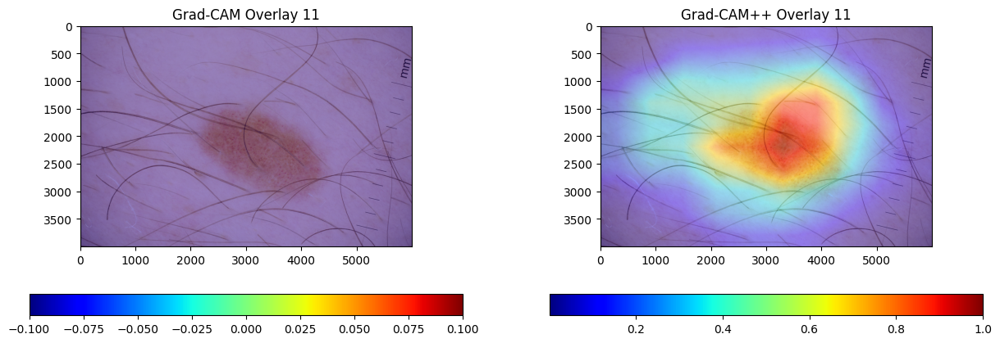

Prediction for image 11: [5.20312e-05]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


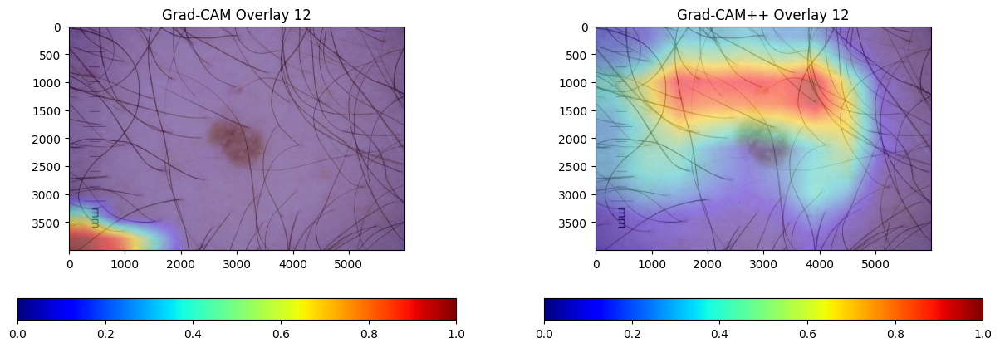

Prediction for image 12: [0.00348569]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


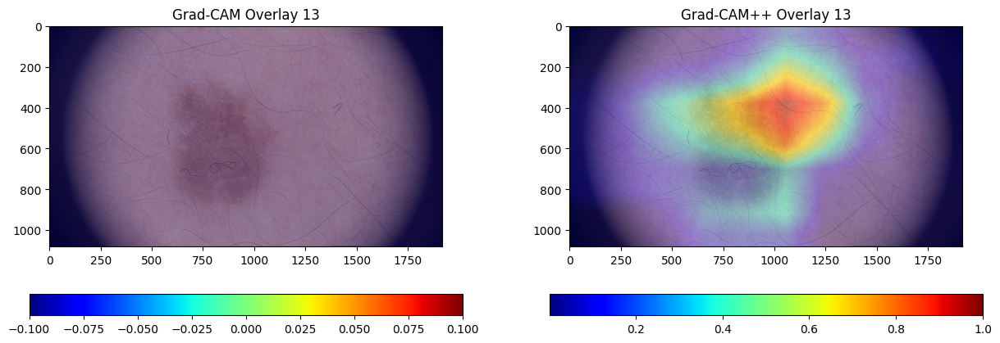

Prediction for image 13: [0.0156033]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


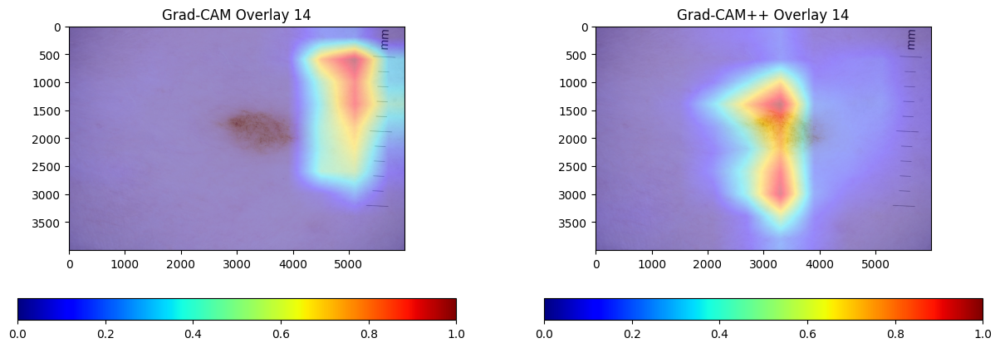

Prediction for image 14: [0.06387454]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


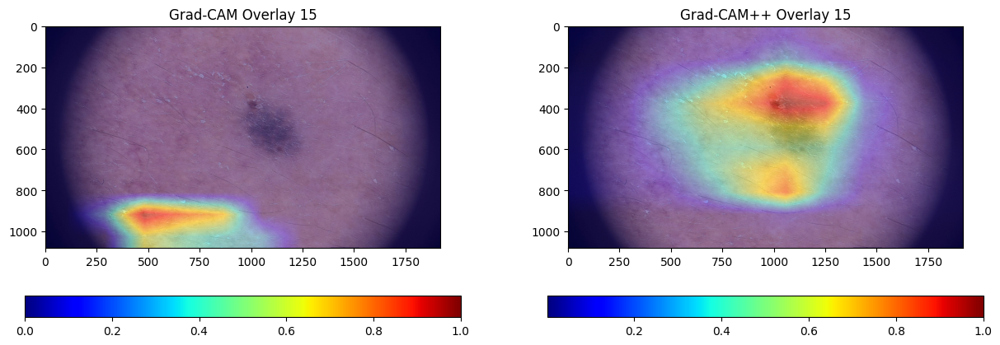

Prediction for image 15: [0.00185087]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


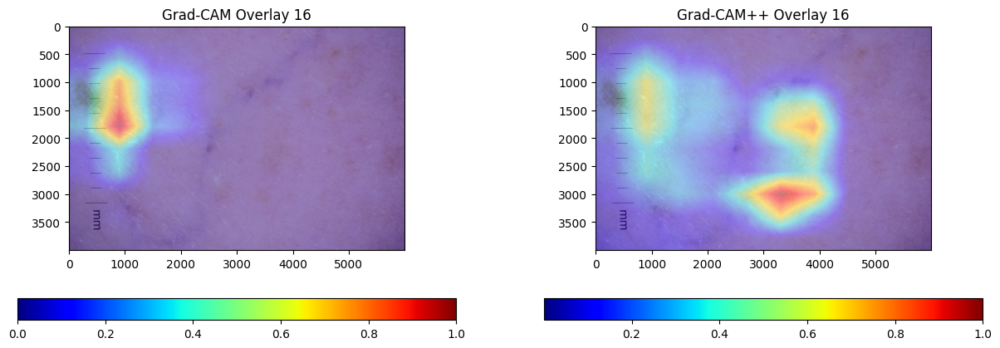

Prediction for image 16: [0.13819186]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


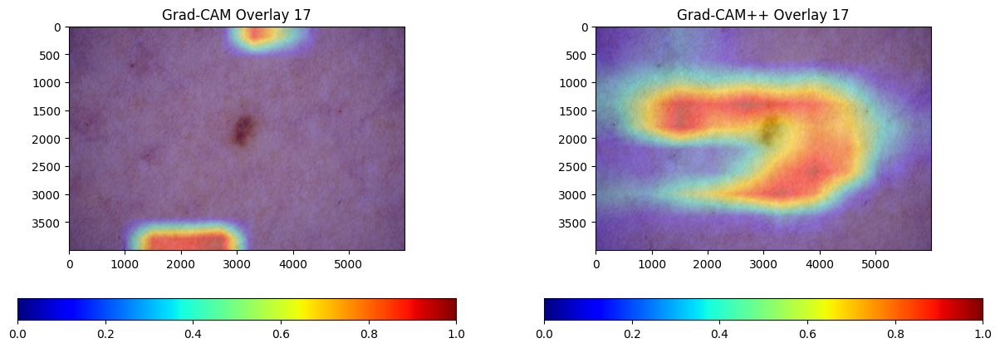

Prediction for image 17: [0.00016419]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


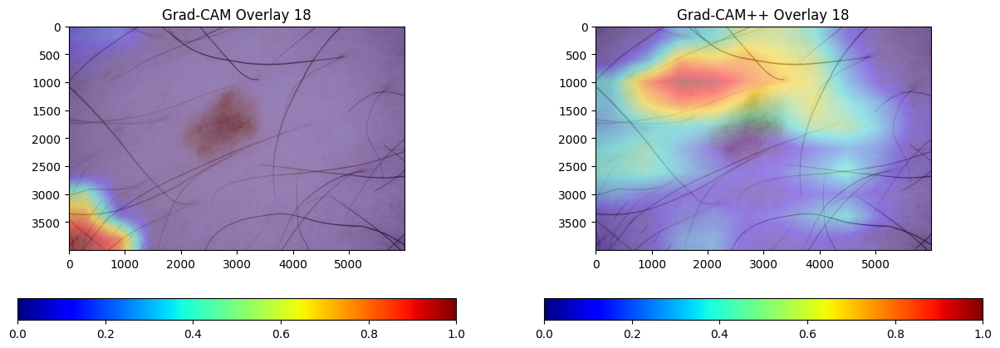

Prediction for image 18: [0.13463704]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


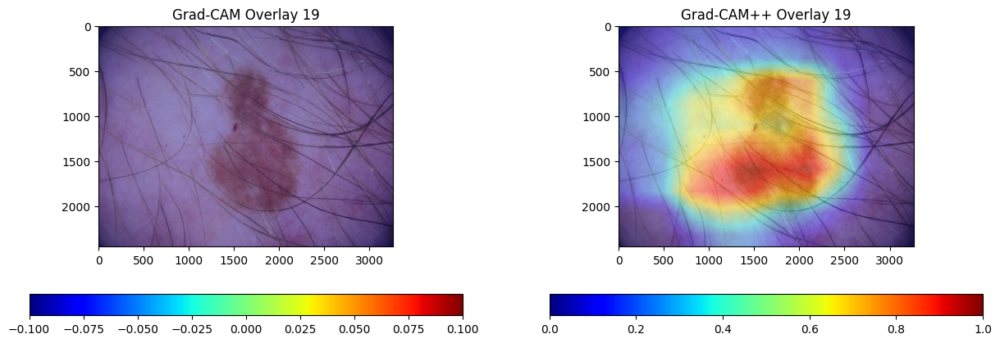

Prediction for image 19: [0.00011296]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


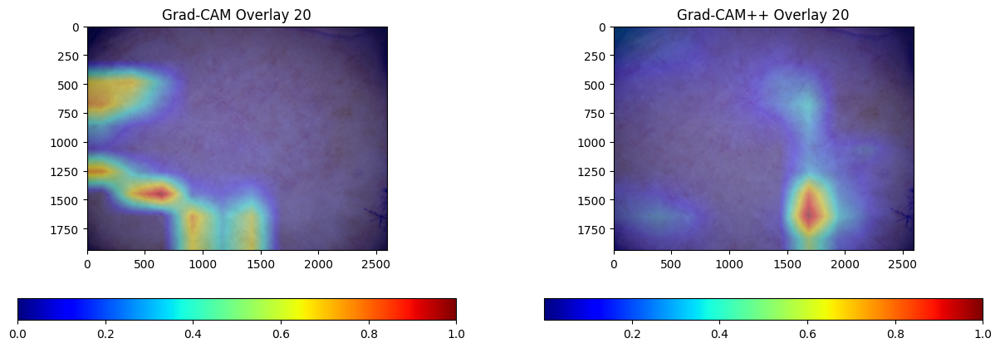

Prediction for image 20: [0.49429038]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


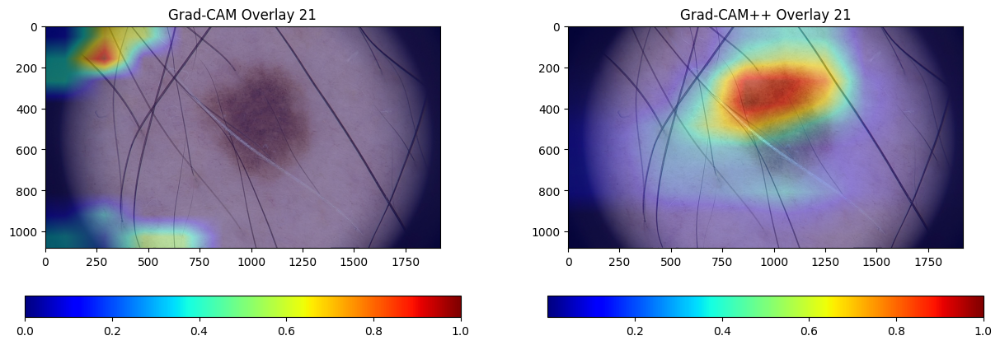

Prediction for image 21: [0.04466898]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


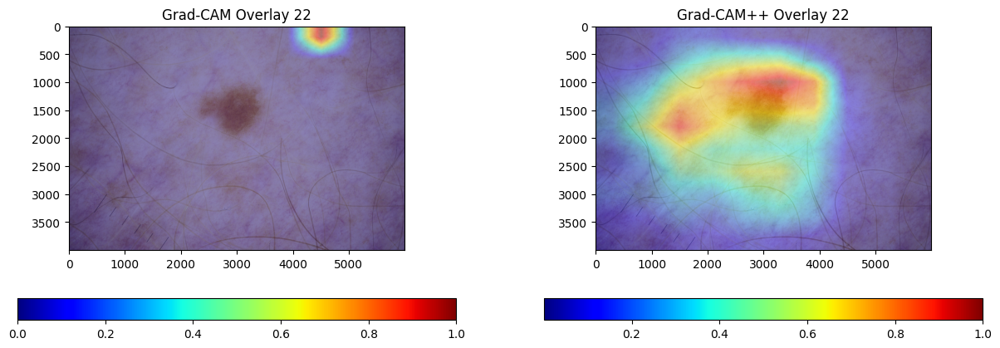

Prediction for image 22: [0.00139422]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


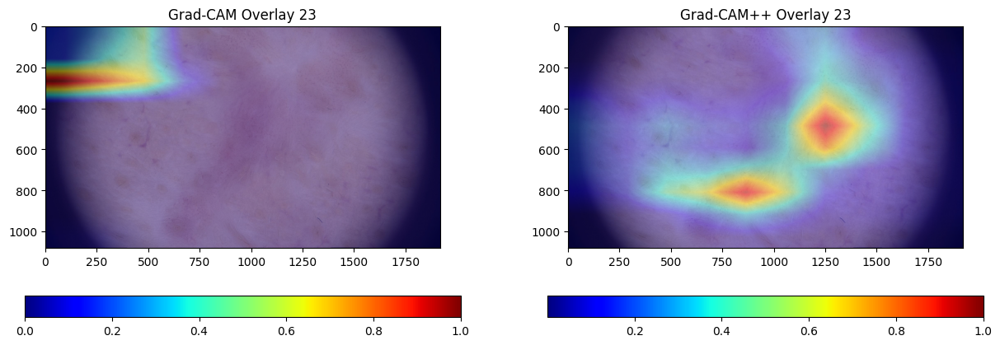

Prediction for image 23: [0.44778037]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


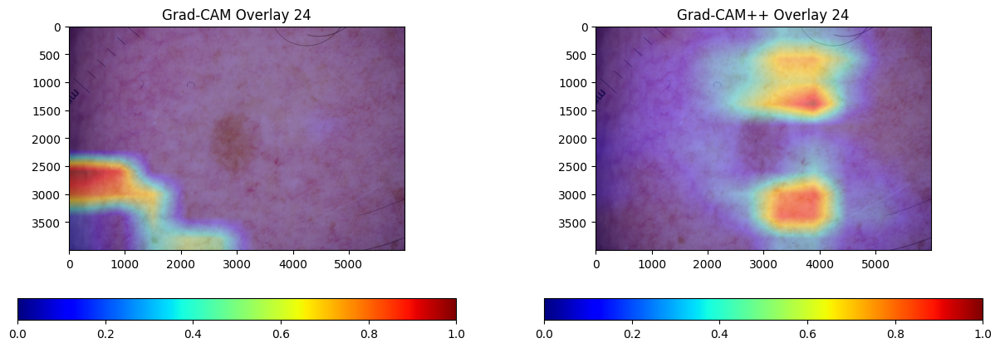

Prediction for image 24: [0.06749476]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


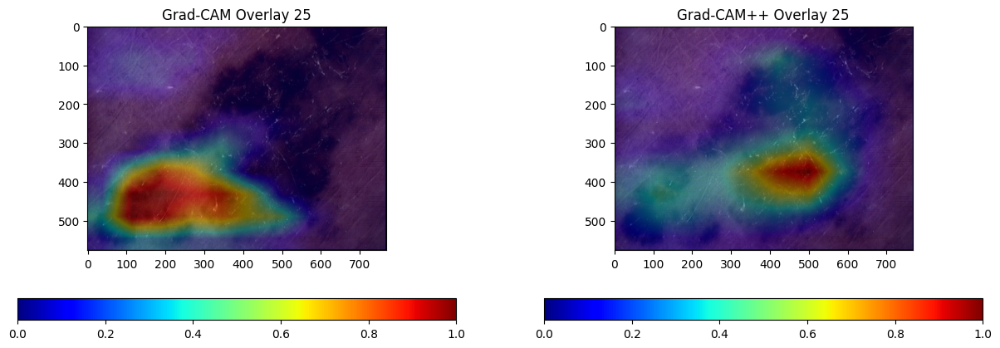

Prediction for image 25: [0.92314696]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


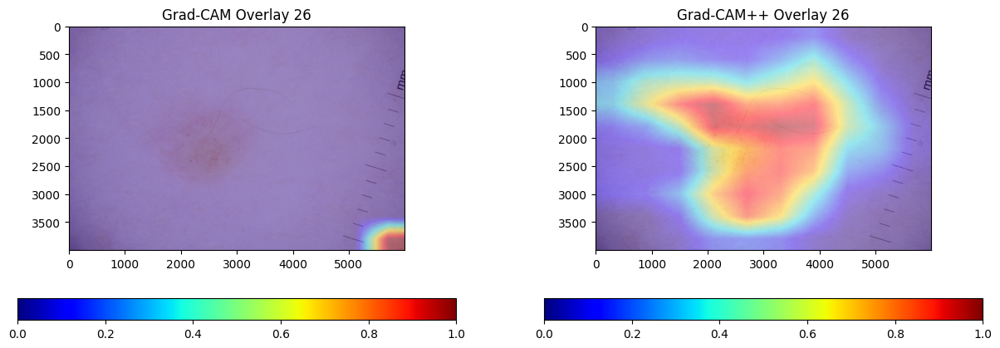

Prediction for image 26: [0.00017279]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


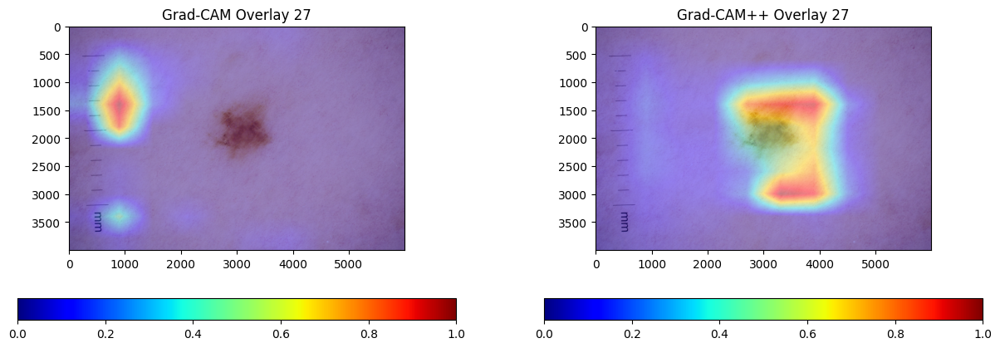

Prediction for image 27: [0.00753283]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


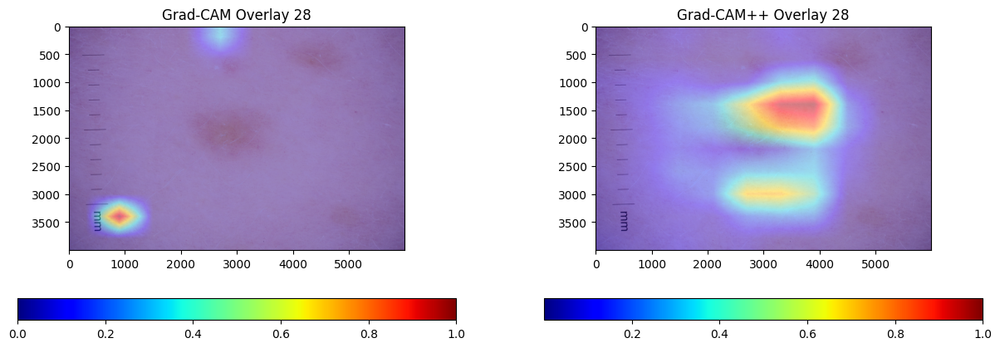

Prediction for image 28: [0.00042407]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


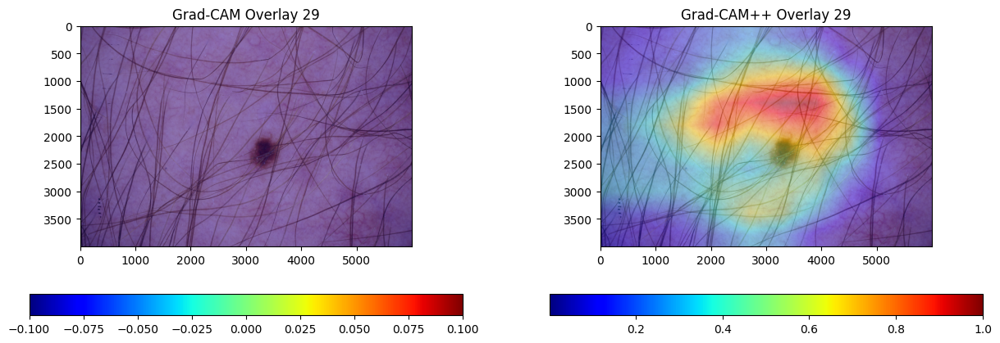

Prediction for image 29: [0.01023495]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


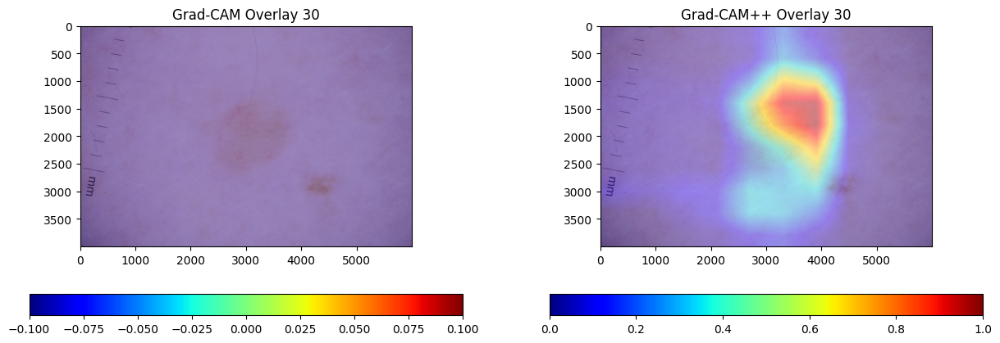

Prediction for image 30: [0.00016571]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


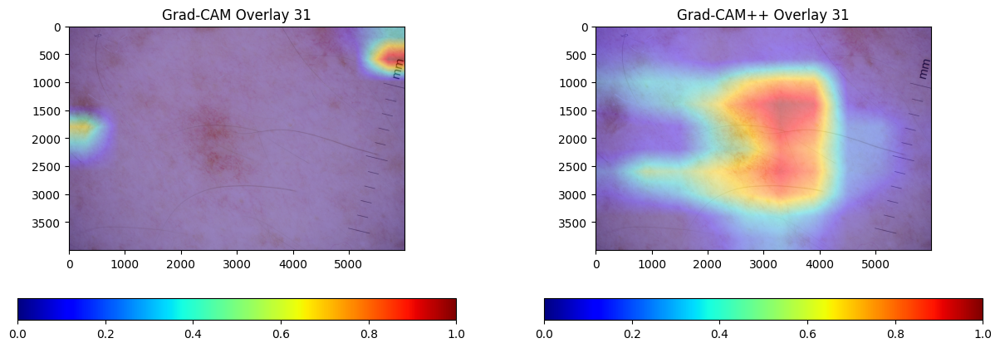

Prediction for image 31: [0.00544805]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


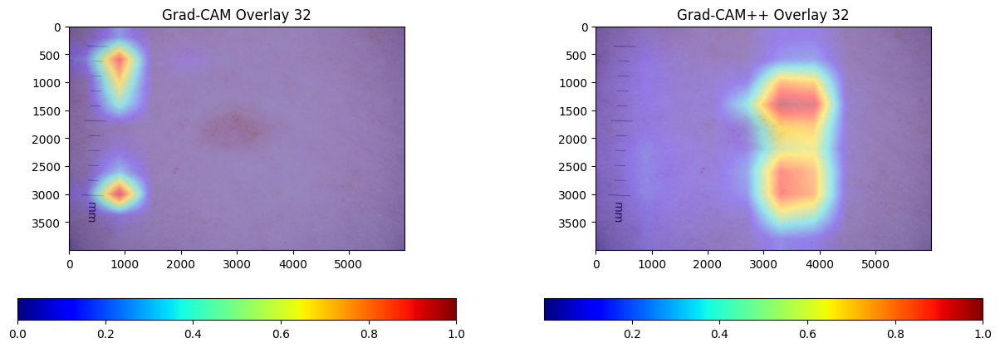

Prediction for image 32: [0.00176045]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


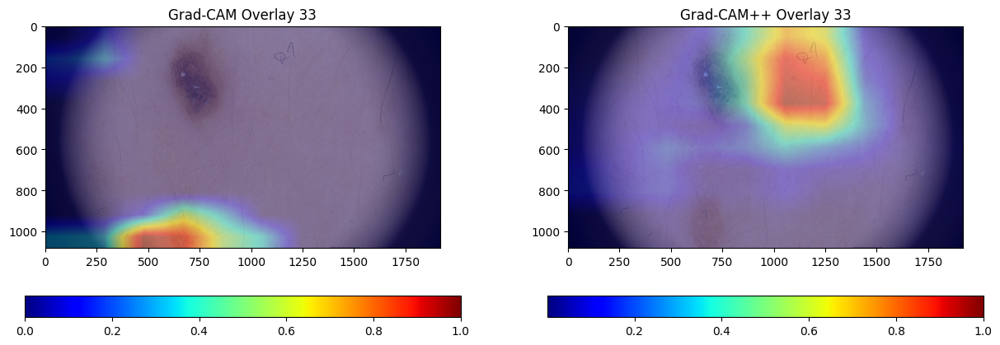

Prediction for image 33: [0.02639822]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


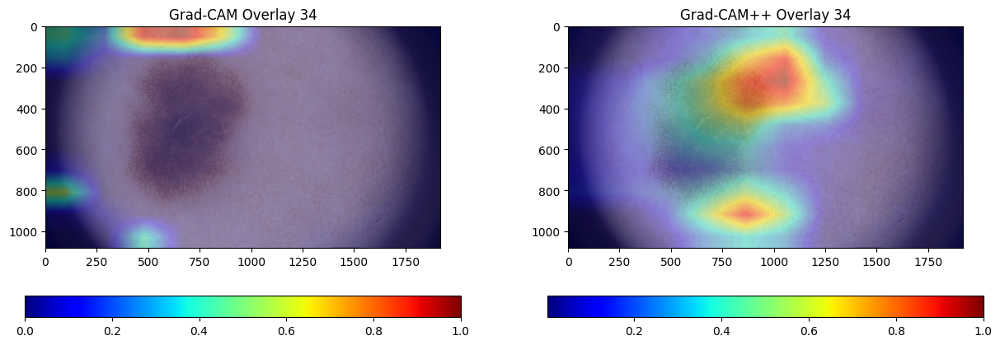

Prediction for image 34: [0.24140719]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


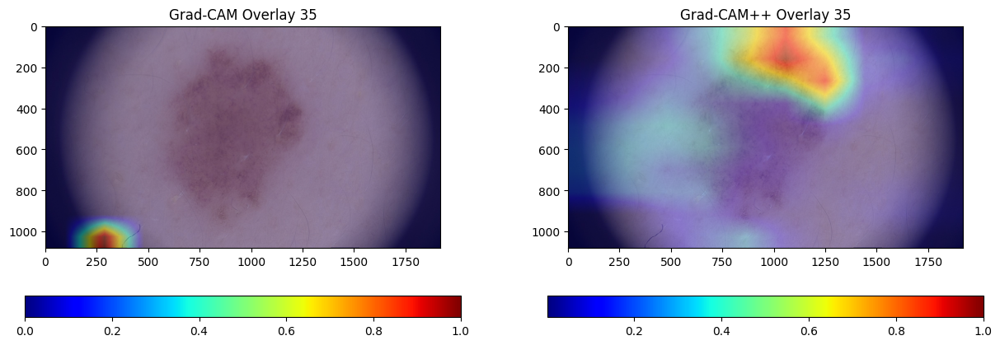

Prediction for image 35: [0.76851326]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


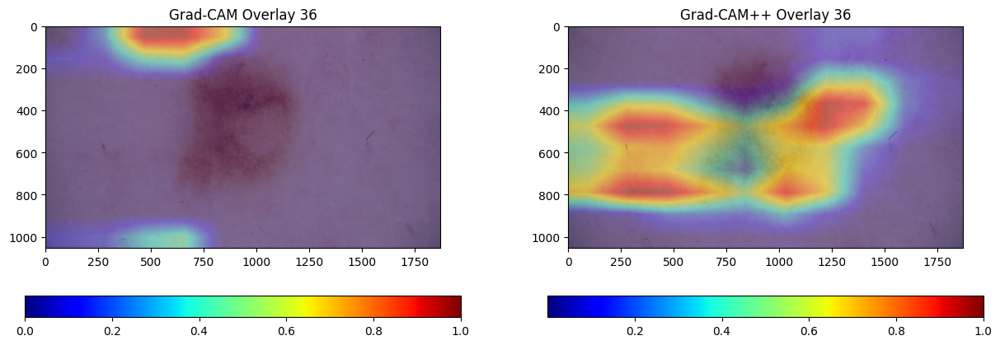

Prediction for image 36: [0.01138058]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


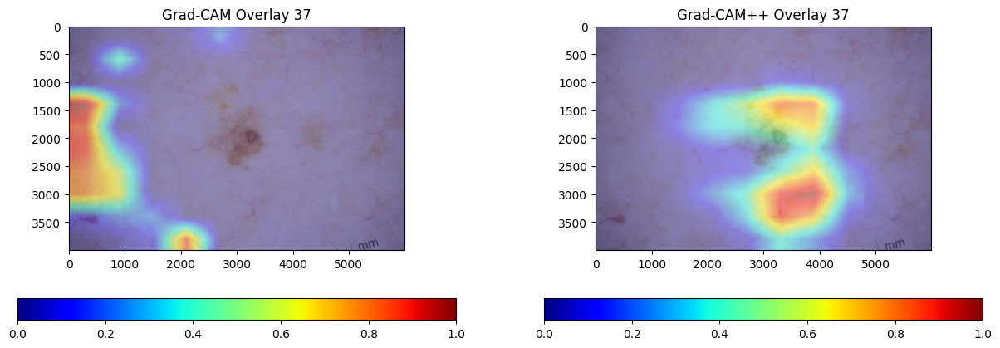

Prediction for image 37: [0.00125938]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


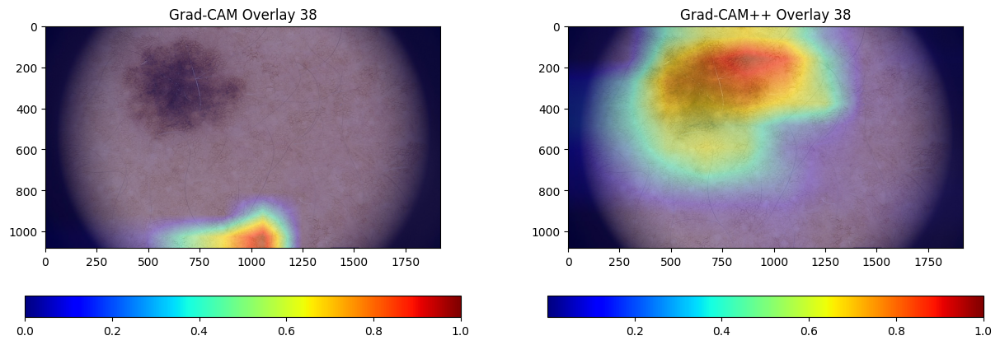

Prediction for image 38: [0.29893285]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


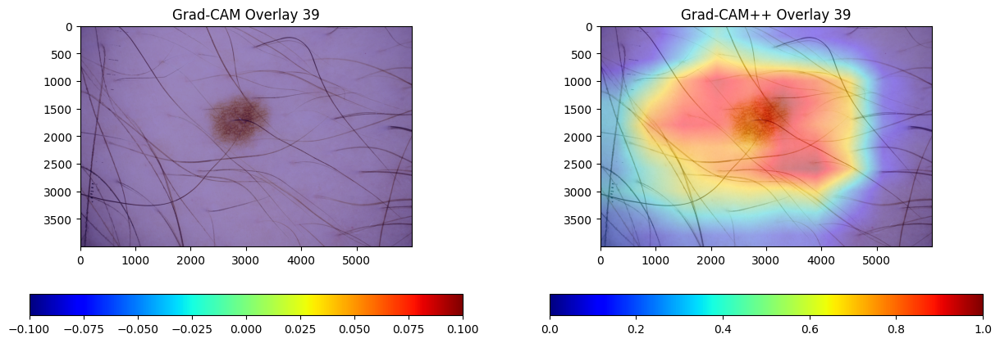

Prediction for image 39: [9.987335e-05]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


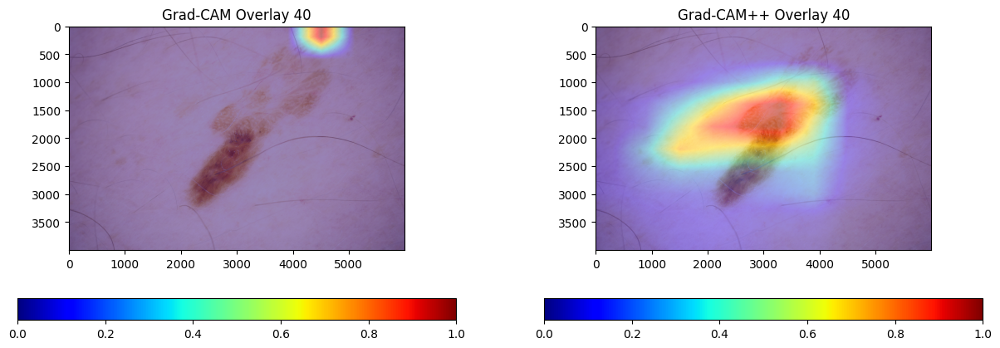

Prediction for image 40: [0.00121642]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


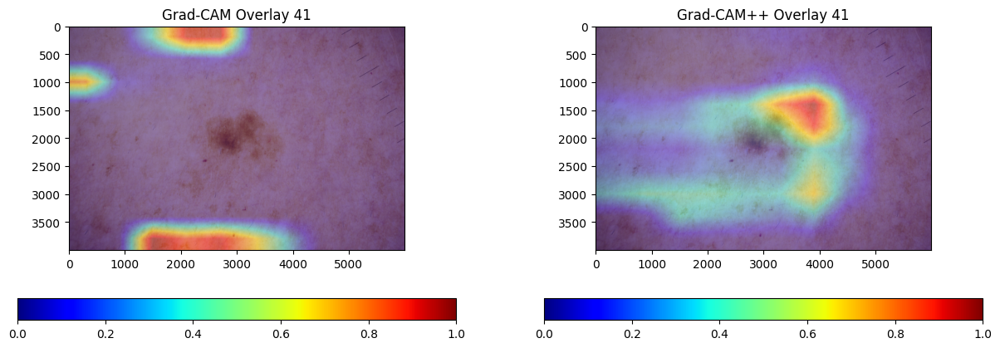

Prediction for image 41: [0.04654654]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


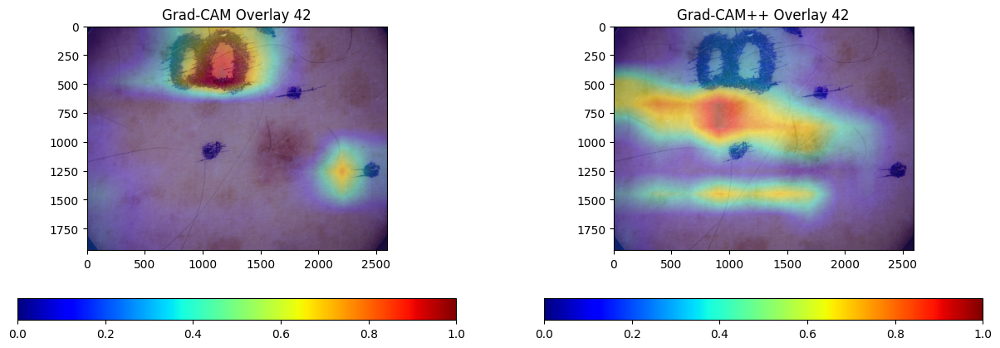

Prediction for image 42: [0.6294469]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


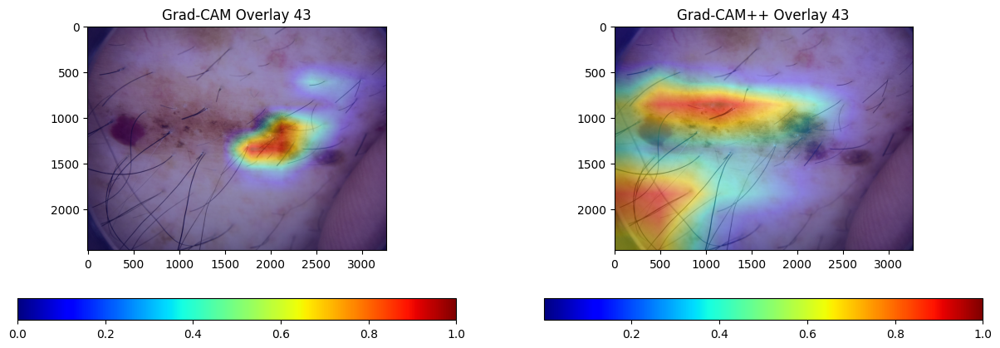

Prediction for image 43: [0.89029473]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


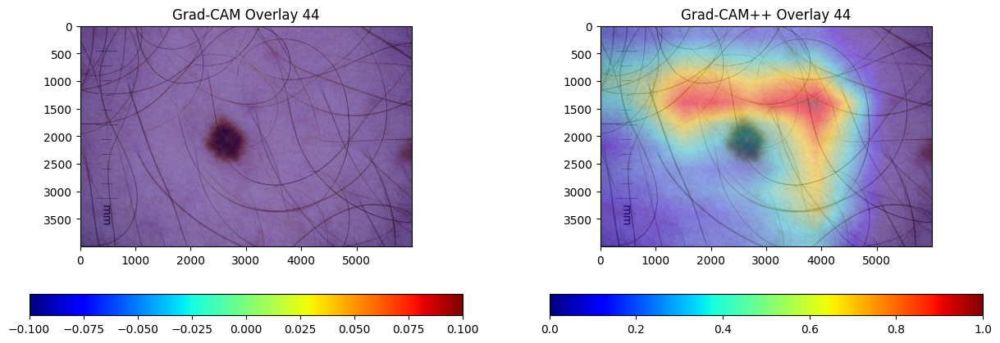

Prediction for image 44: [0.00111128]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


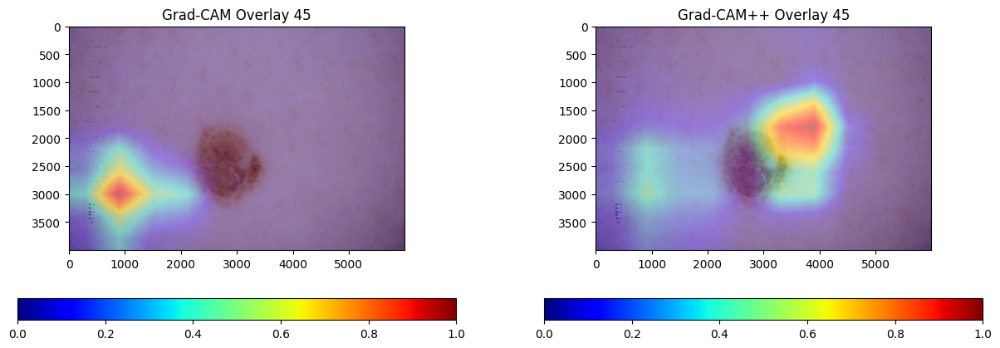

Prediction for image 45: [0.02079721]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


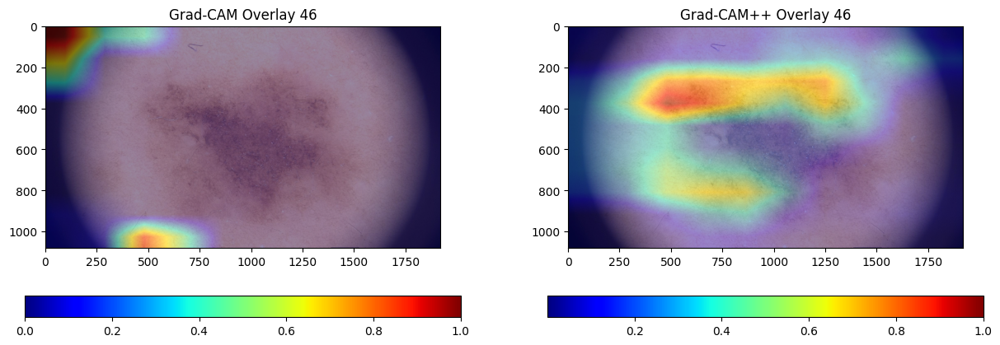

Prediction for image 46: [0.5157742]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


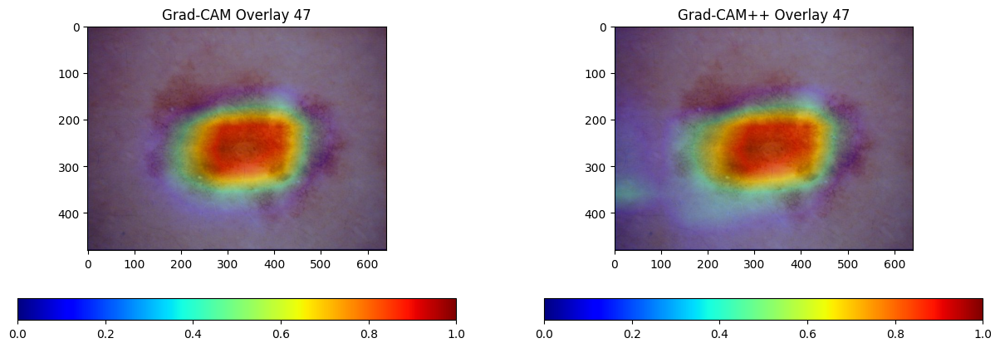

Prediction for image 47: [0.9619916]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


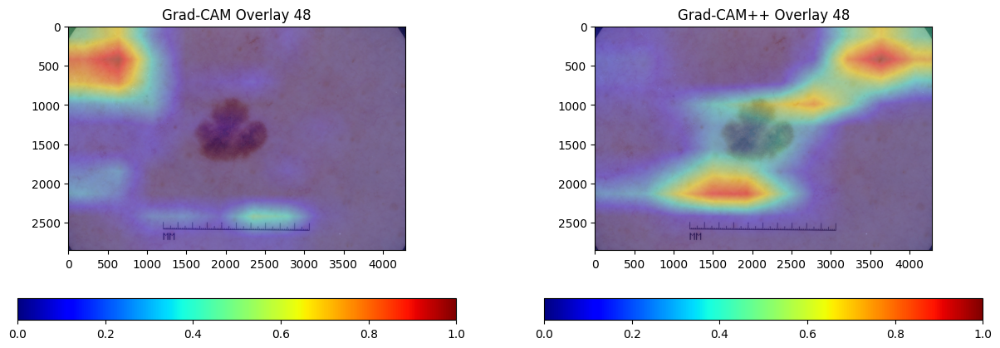

Prediction for image 48: [0.5946614]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


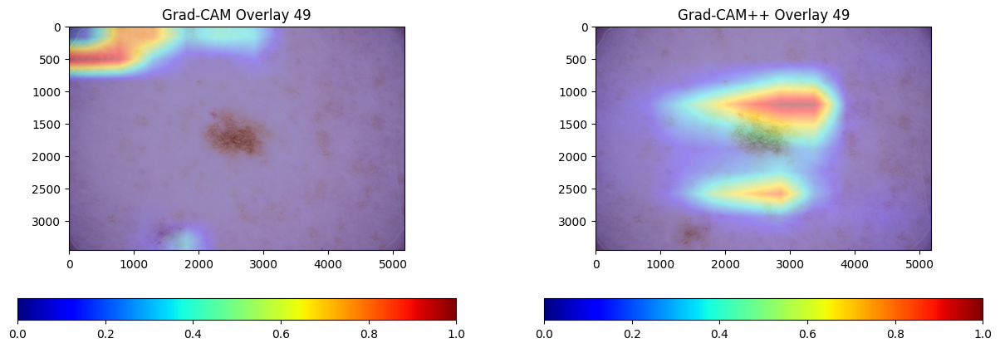

Prediction for image 49: [0.00110592]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


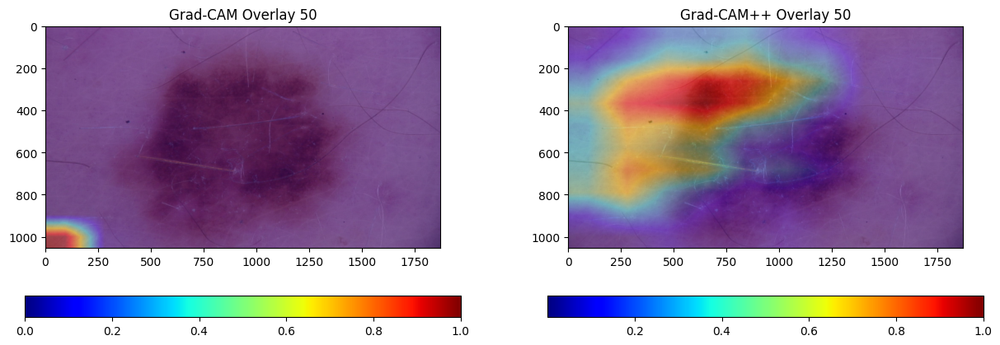

Prediction for image 50: [0.00208879]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


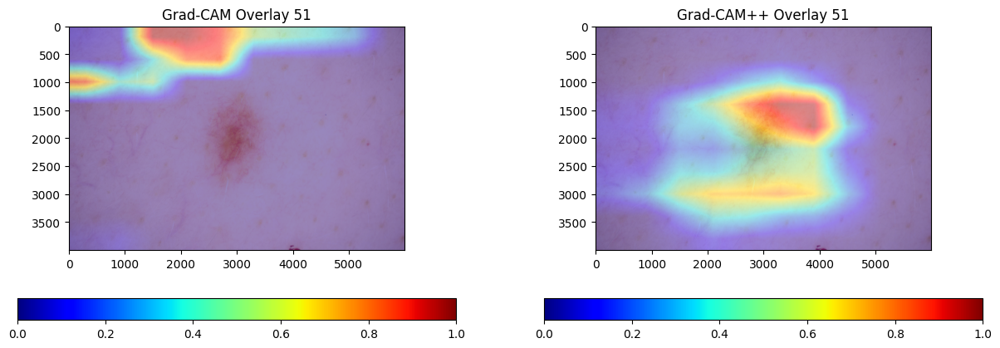

Prediction for image 51: [0.00093413]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


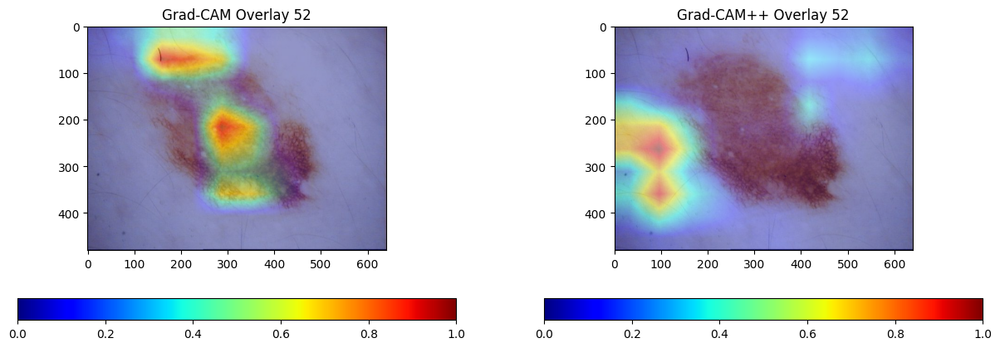

Prediction for image 52: [0.48559496]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


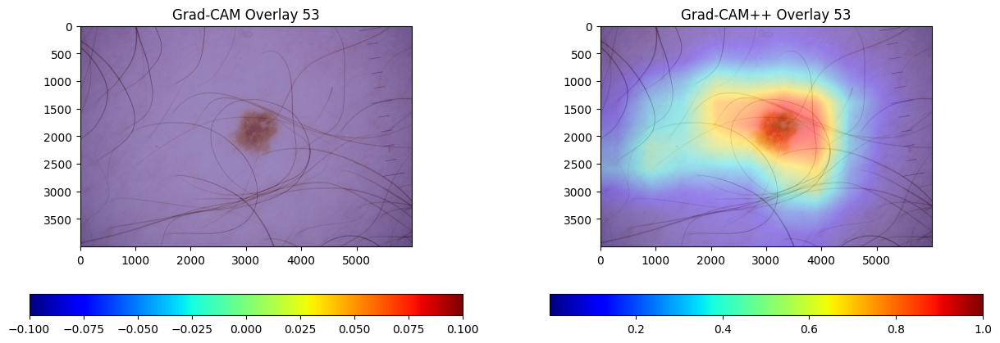

Prediction for image 53: [1.3689713e-06]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


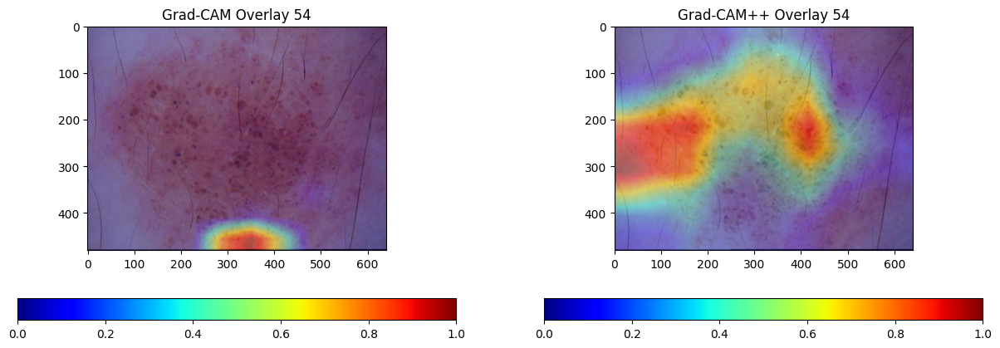

Prediction for image 54: [0.4774934]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


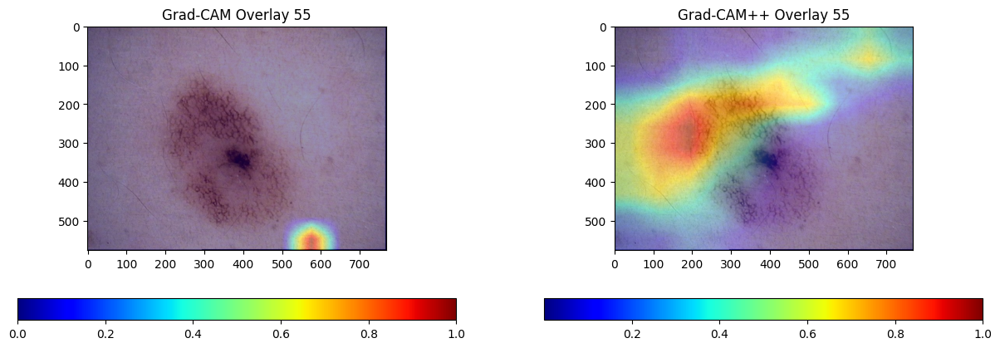

Prediction for image 55: [0.78259027]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


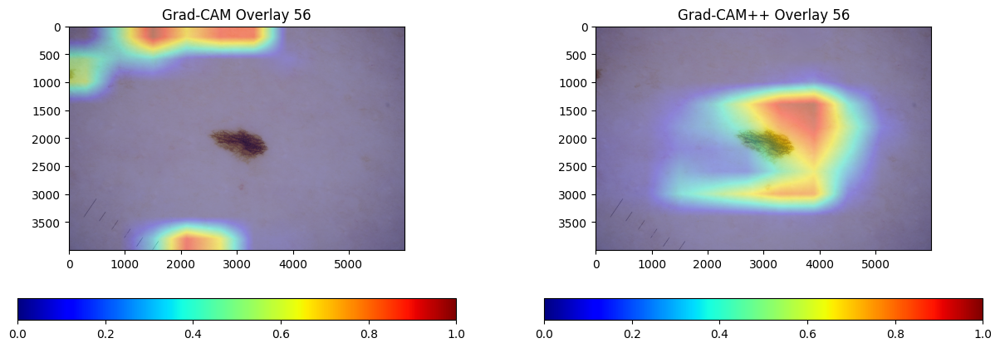

Prediction for image 56: [0.00012047]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


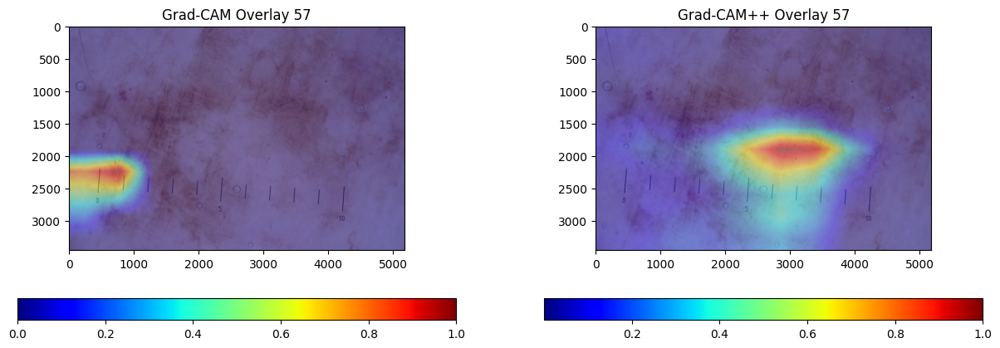

Prediction for image 57: [0.15720443]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


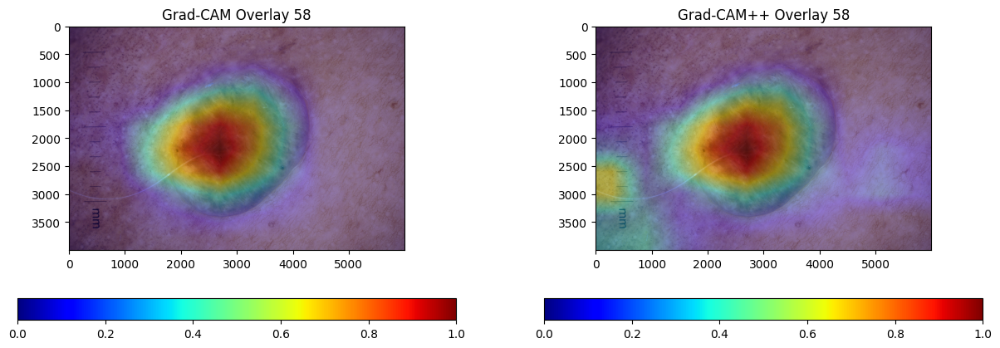

Prediction for image 58: [0.9898184]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


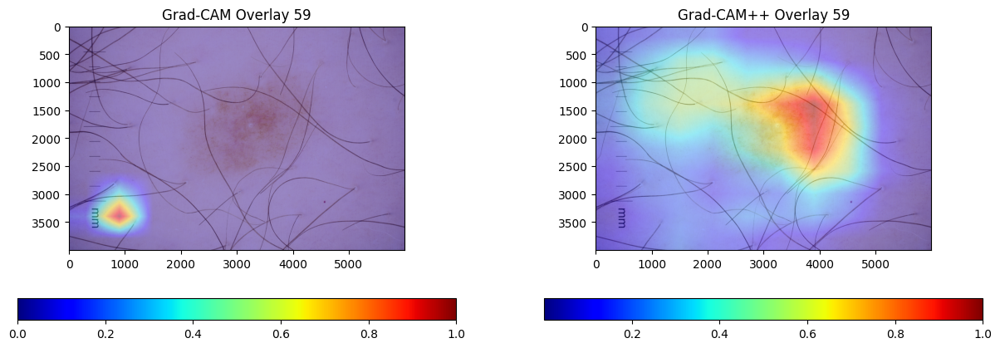

Prediction for image 59: [0.00169451]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


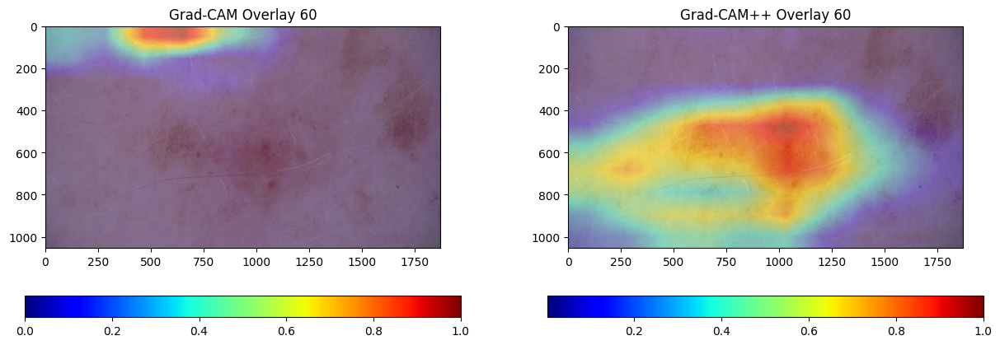

Prediction for image 60: [0.00562594]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


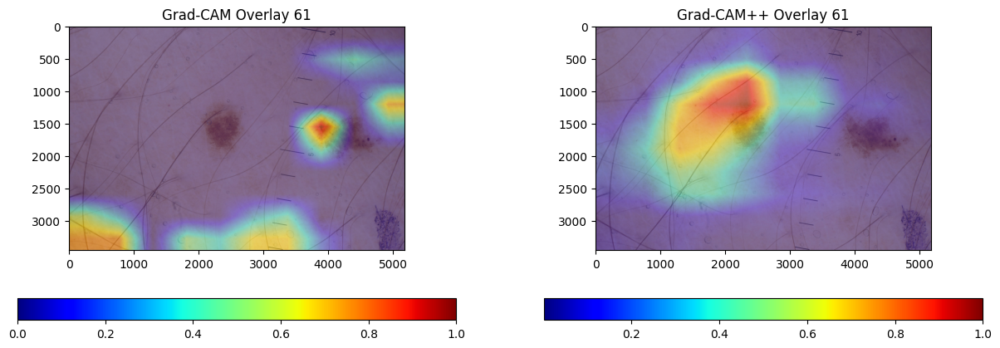

Prediction for image 61: [0.01748297]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


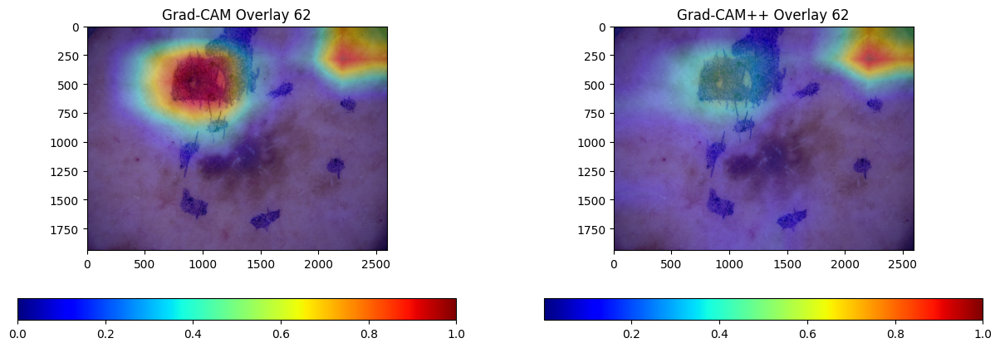

Prediction for image 62: [0.9785411]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


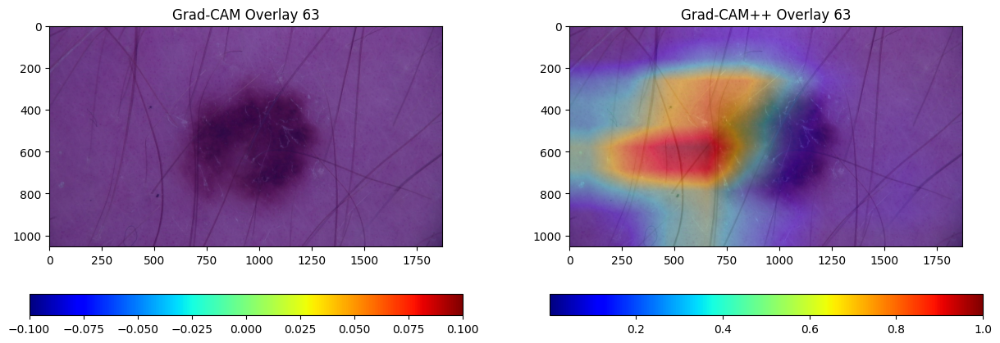

Prediction for image 63: [0.00444014]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


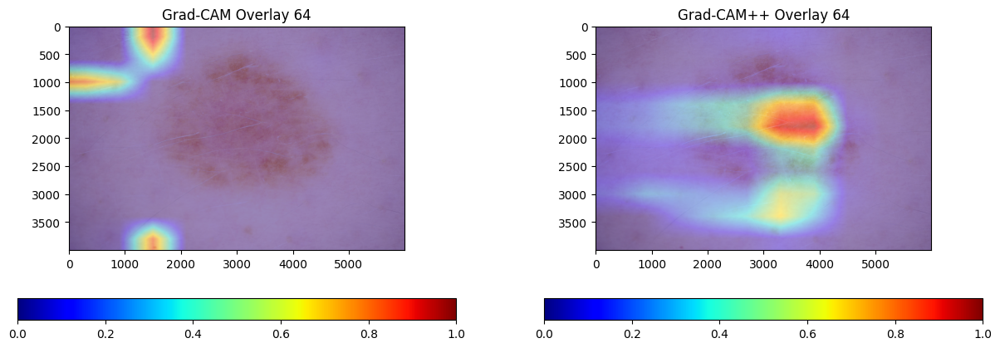

Prediction for image 64: [0.00873064]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


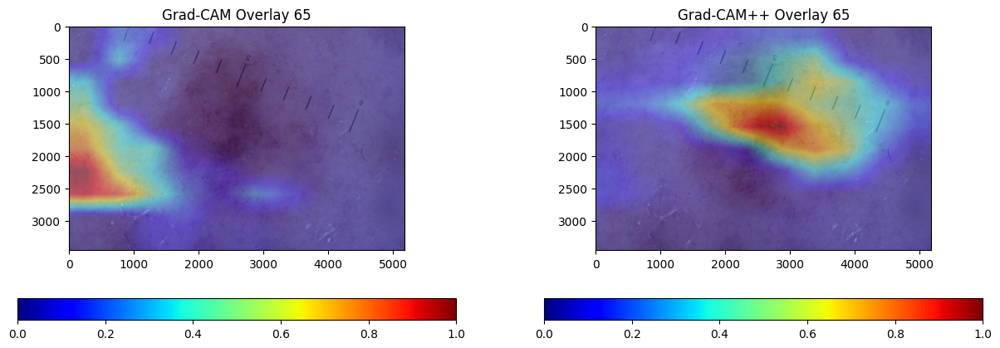

Prediction for image 65: [0.34047616]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


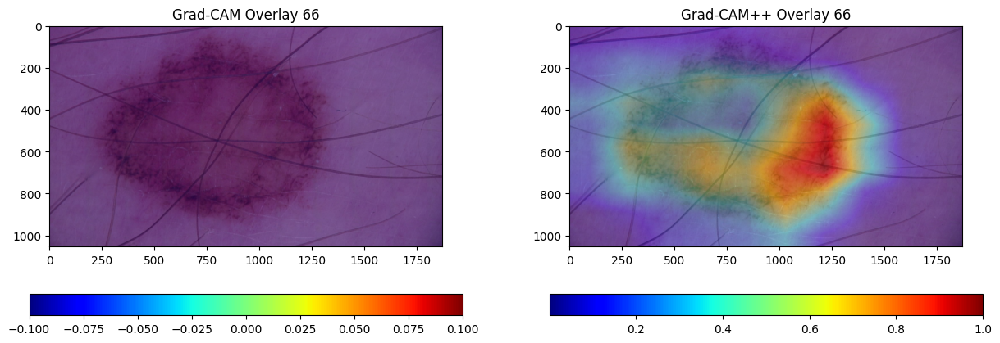

Prediction for image 66: [0.00788538]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


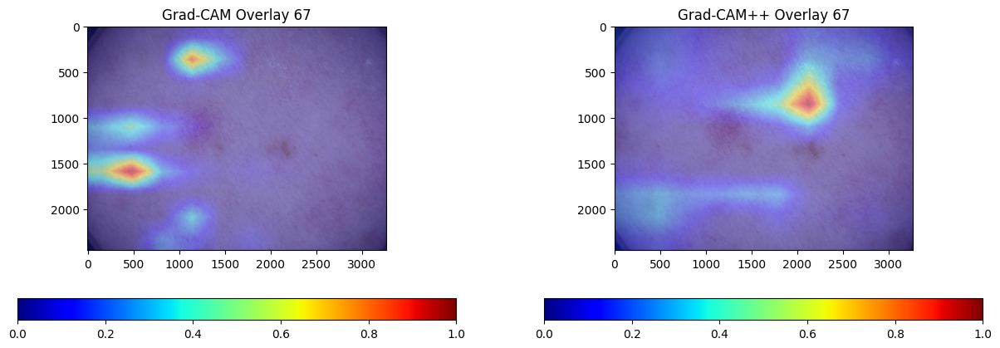

Prediction for image 67: [0.7830782]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


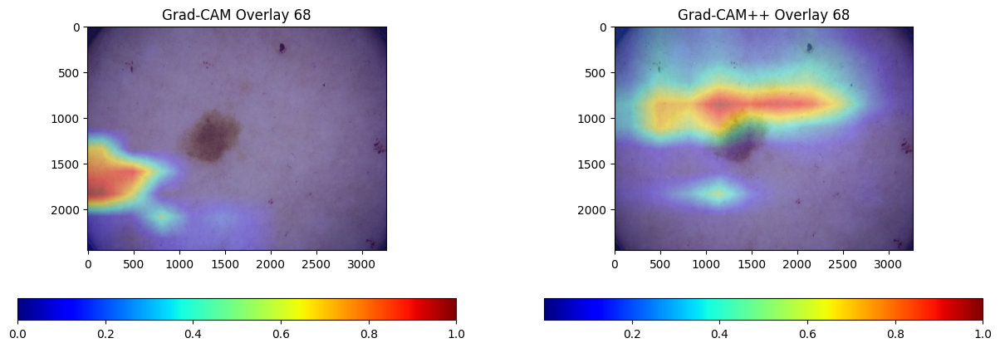

Prediction for image 68: [0.0240288]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


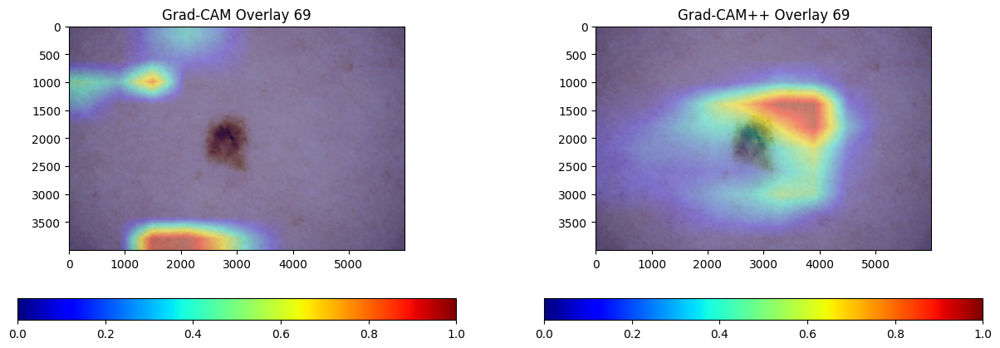

Prediction for image 69: [0.00448771]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


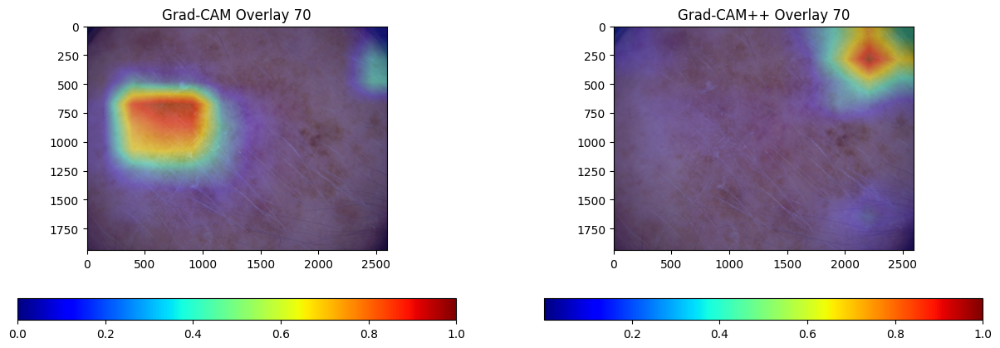

Prediction for image 70: [0.9836167]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


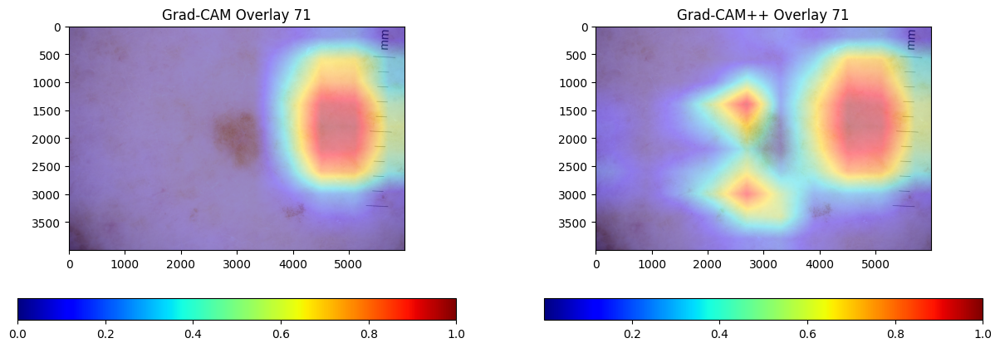

Prediction for image 71: [0.5751099]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


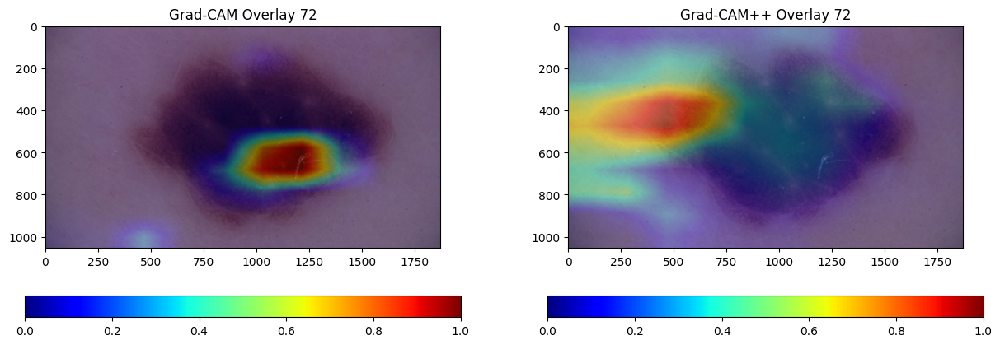

Prediction for image 72: [0.3578665]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


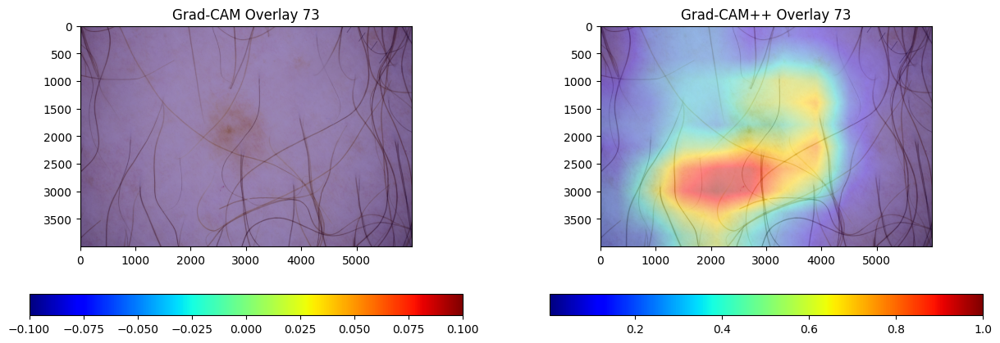

Prediction for image 73: [0.00082625]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


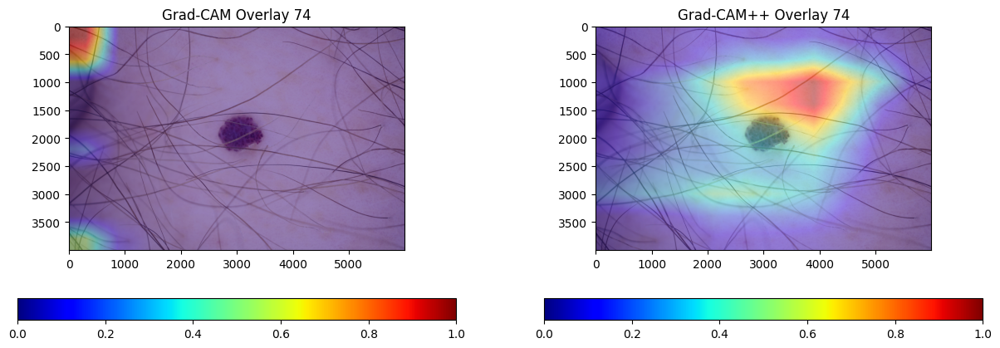

Prediction for image 74: [0.0289061]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


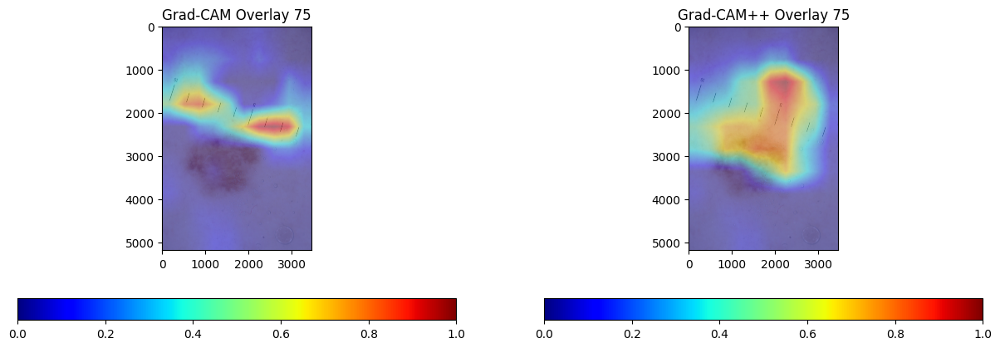

Prediction for image 75: [0.42854947]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


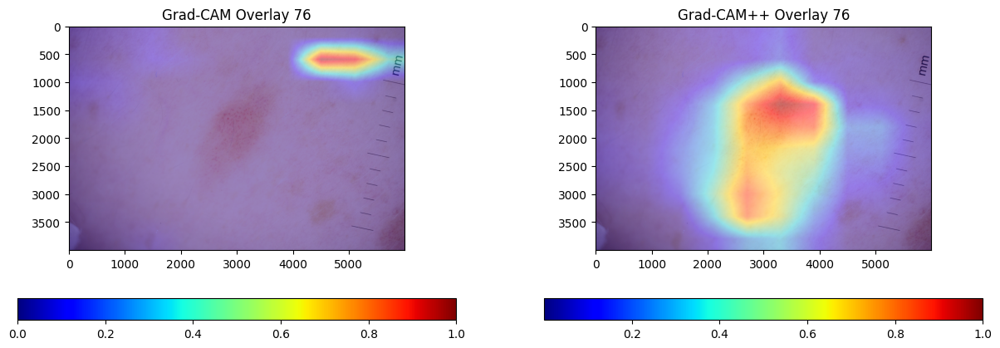

Prediction for image 76: [0.00277791]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


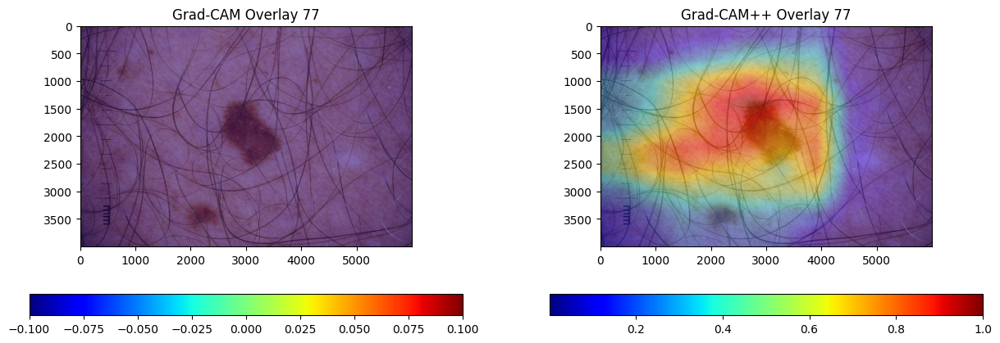

Prediction for image 77: [0.00059614]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


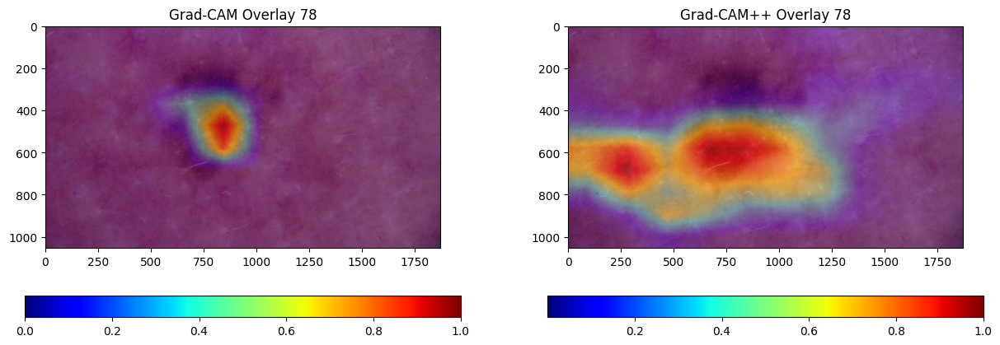

Prediction for image 78: [0.83057547]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


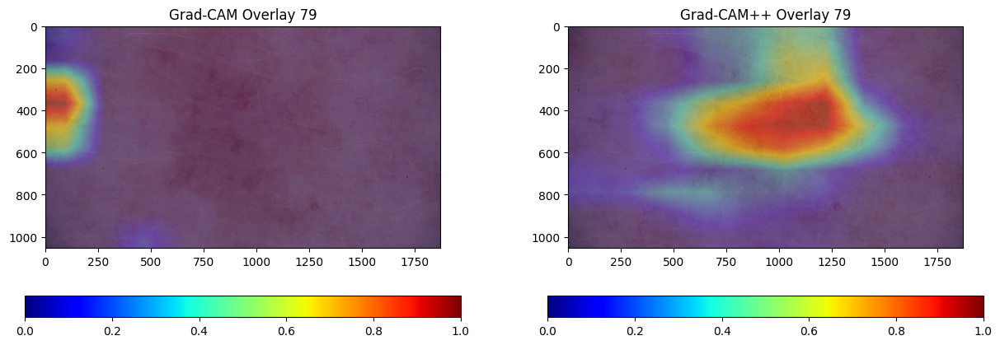

Prediction for image 79: [0.00777894]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


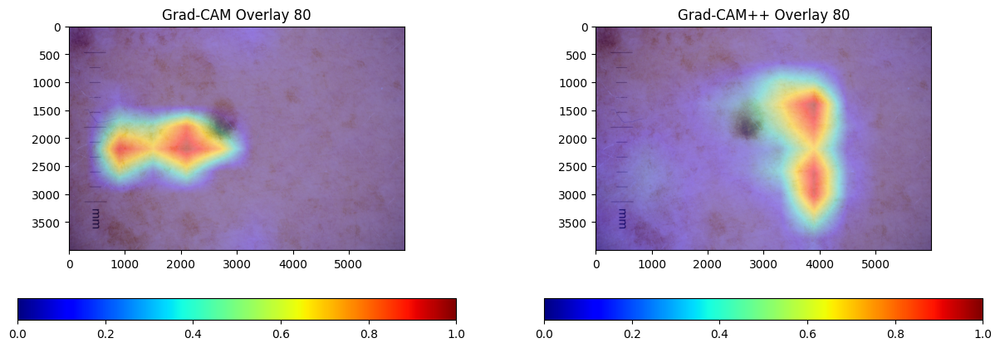

Prediction for image 80: [0.1806897]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


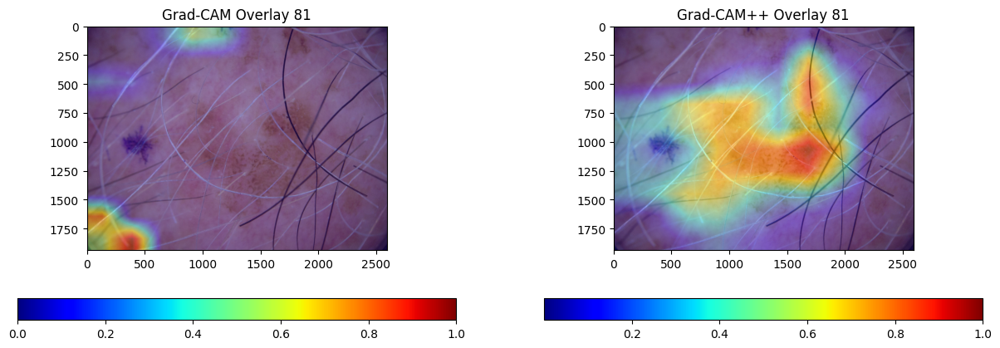

Prediction for image 81: [0.01047415]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


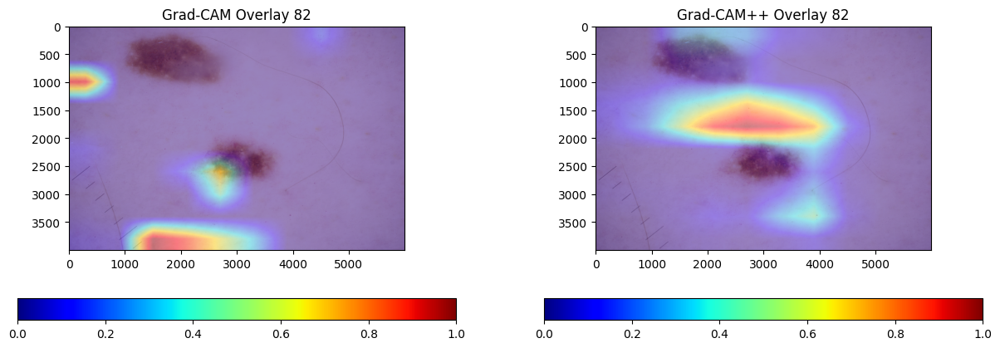

Prediction for image 82: [0.02580954]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


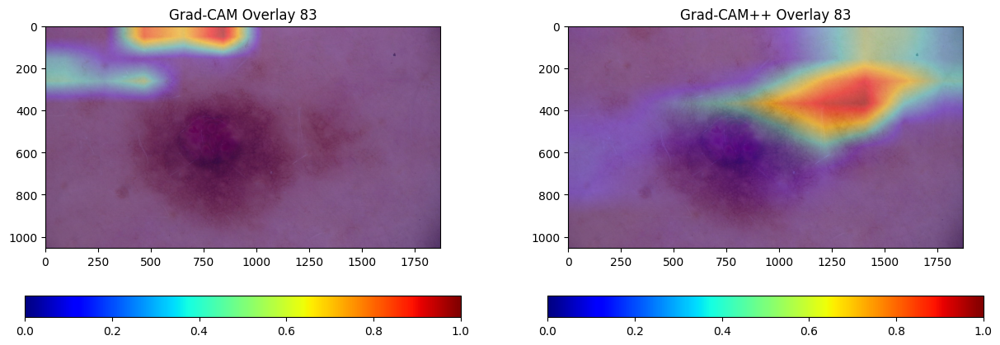

Prediction for image 83: [0.01236909]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


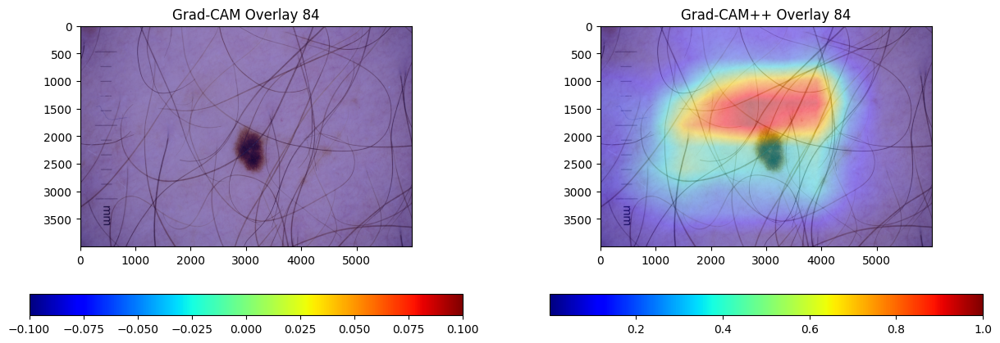

Prediction for image 84: [0.01222877]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


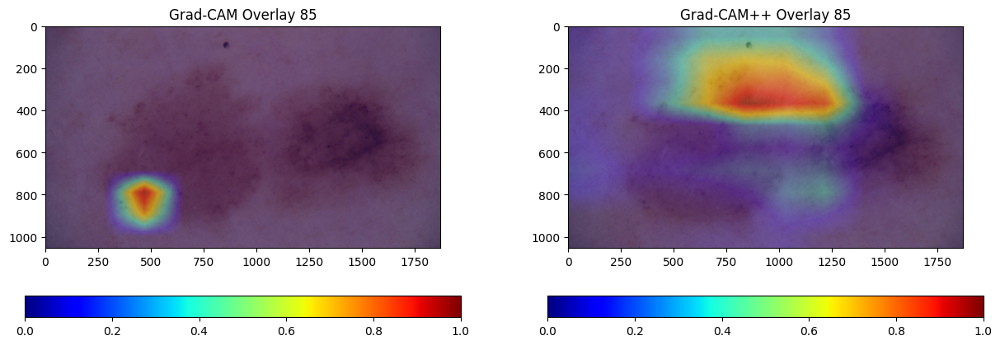

Prediction for image 85: [0.0470098]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


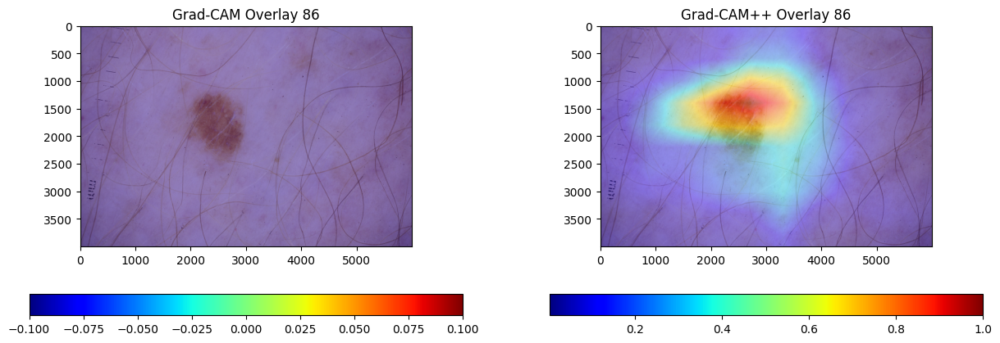

Prediction for image 86: [0.00142065]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


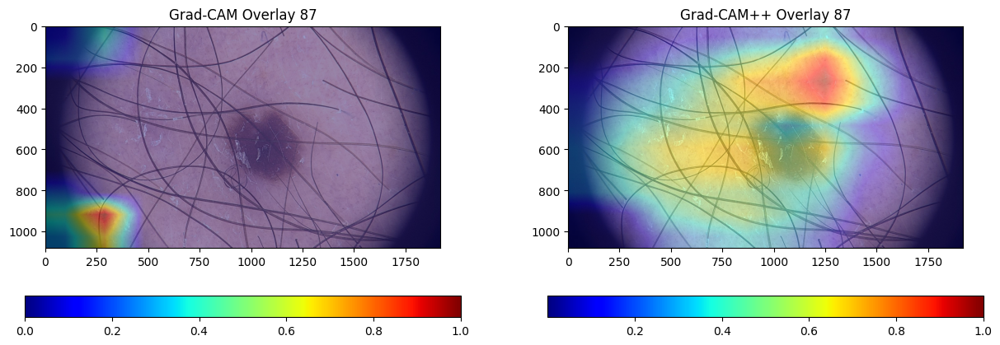

Prediction for image 87: [0.10562196]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


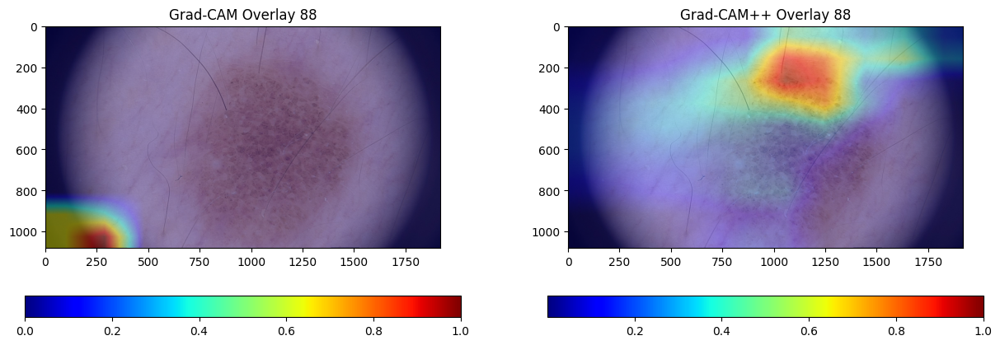

Prediction for image 88: [0.24734291]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


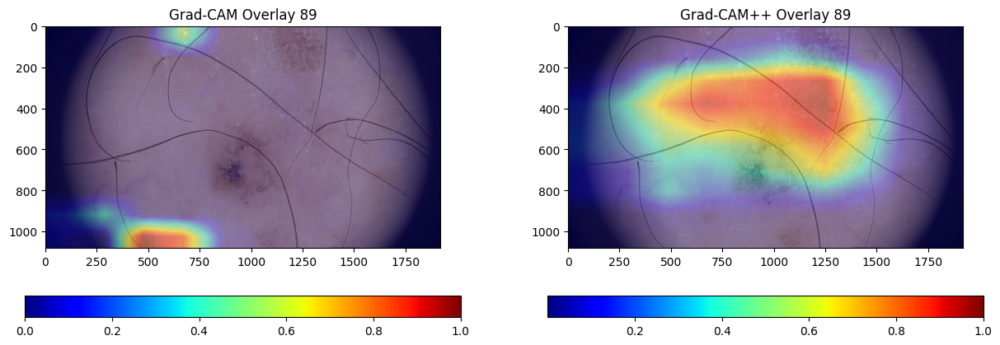

Prediction for image 89: [0.00153123]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


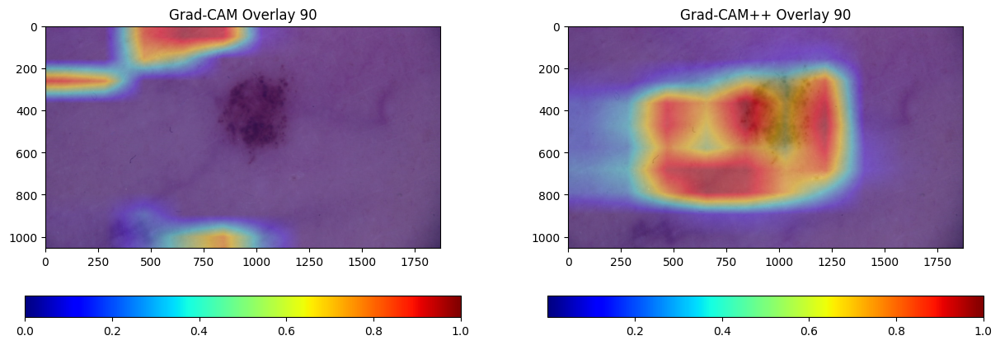

Prediction for image 90: [0.00887058]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


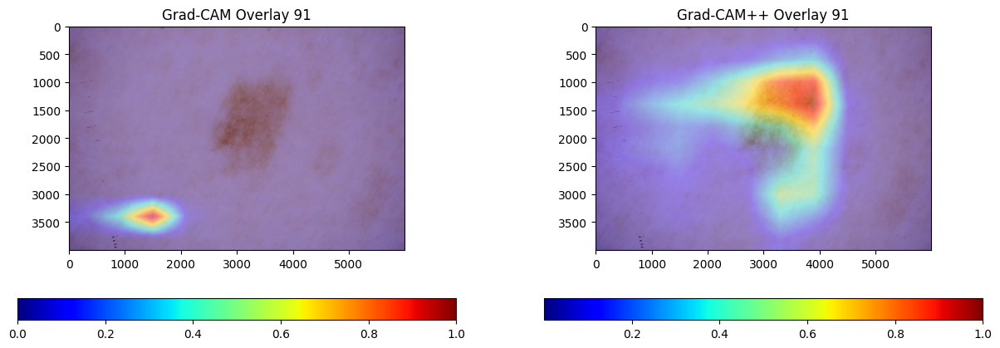

Prediction for image 91: [0.00221523]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


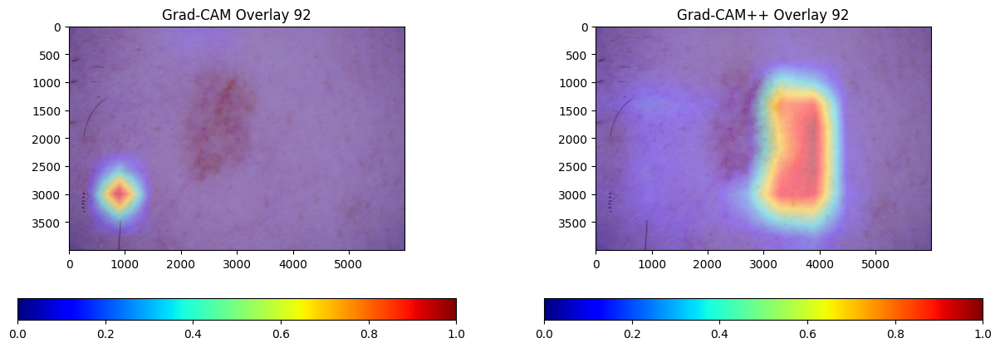

Prediction for image 92: [0.00676253]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


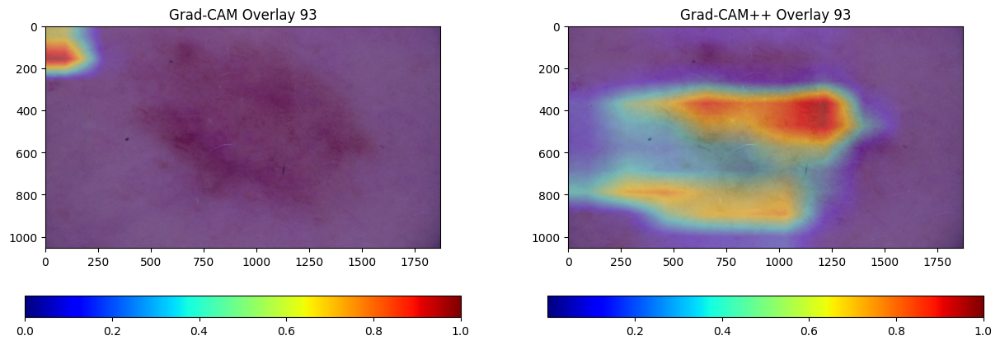

Prediction for image 93: [0.00909089]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


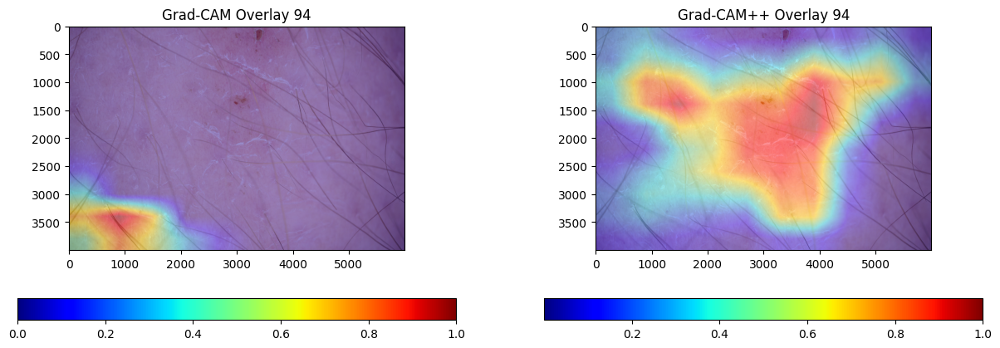

Prediction for image 94: [0.00045219]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


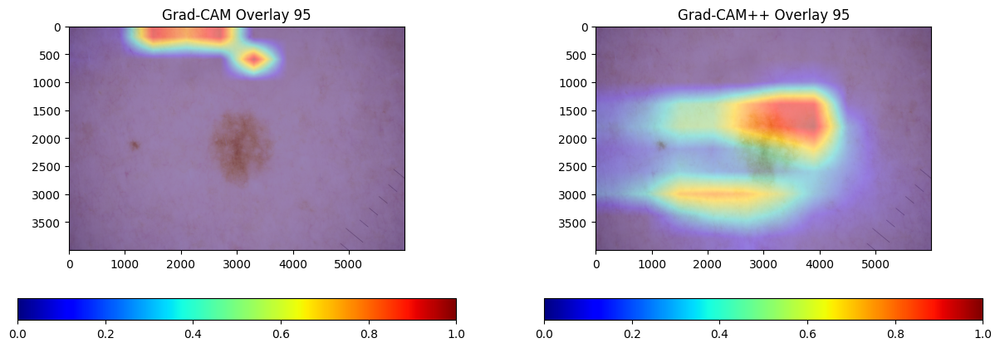

Prediction for image 95: [0.00015841]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


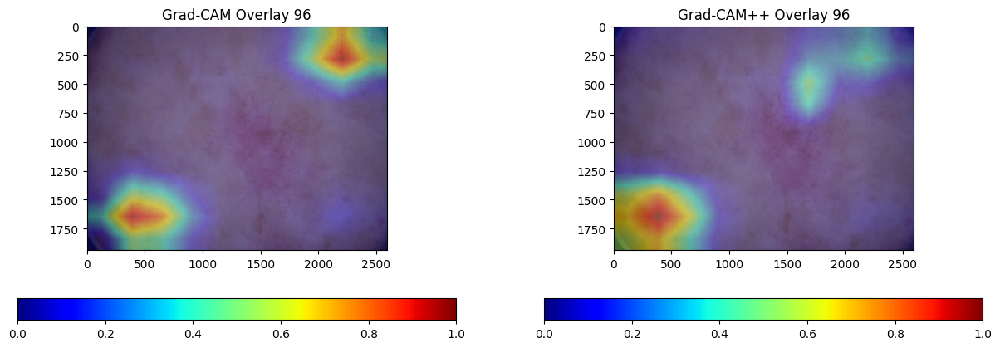

Prediction for image 96: [0.9969522]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


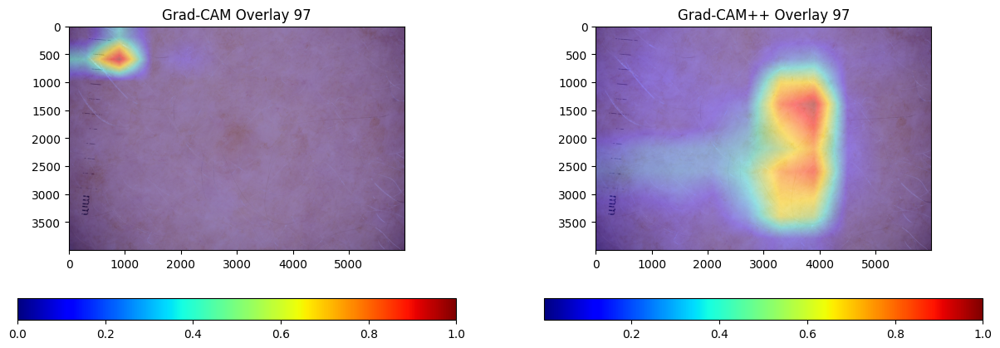

Prediction for image 97: [0.00224095]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


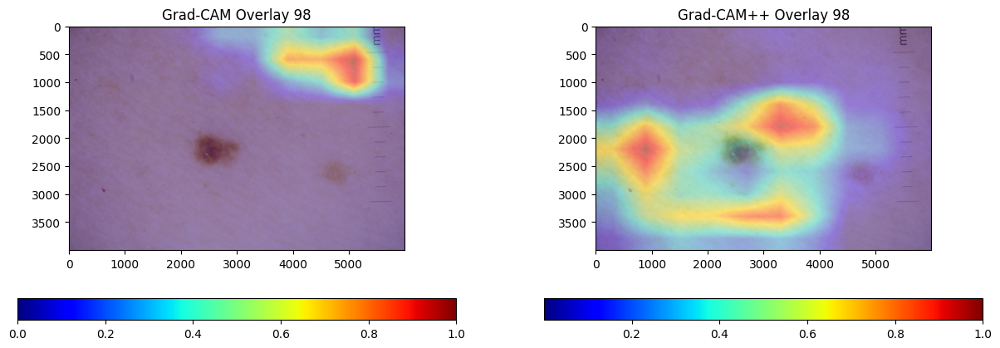

Prediction for image 98: [0.02116871]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


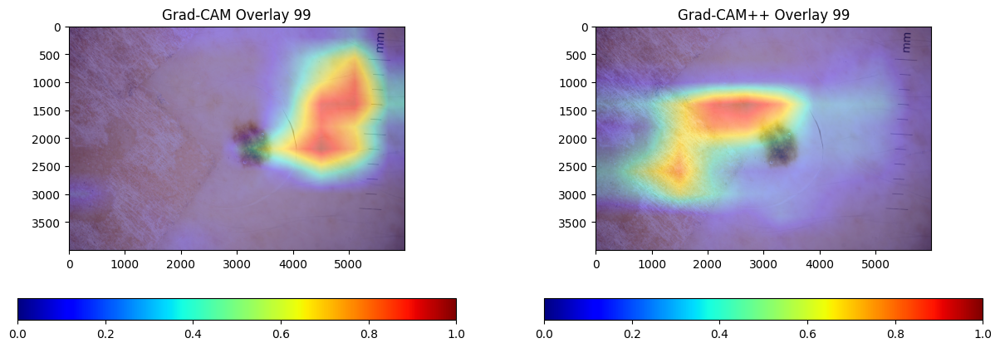

Prediction for image 99: [0.532536]
Image shape: (1, 300, 300, 3)
Gender shape: (1, 1)
Age shape: (1, 1)
Site shape: (1, 1)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


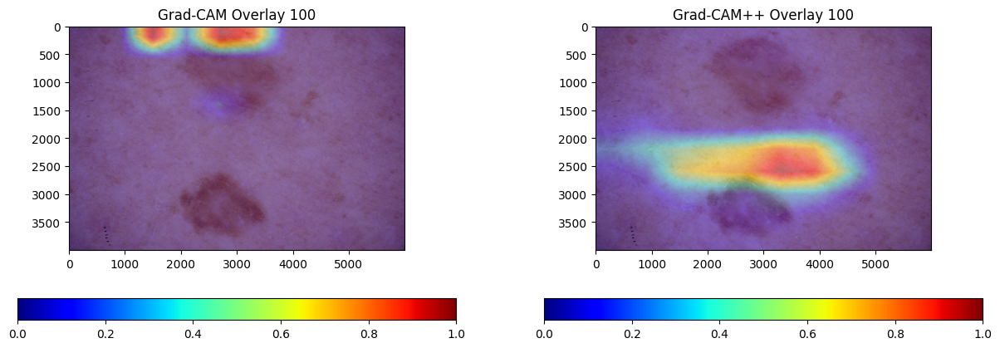

Prediction for image 100: [0.06020633]
Predictions for the first 100 images: [3.45233385e-03 2.27936376e-02 1.67846251e-02 7.94681728e-06
 7.89223413e-04 2.21934710e-02 2.84733891e-01 5.95250204e-02
 8.23351145e-02 3.21373506e-03 5.20311987e-05 3.48568778e-03
 1.56033002e-02 6.38745353e-02 1.85087067e-03 1.38191864e-01
 1.64185927e-04 1.34637043e-01 1.12955066e-04 4.94290382e-01
 4.46689837e-02 1.39422447e-03 4.47780371e-01 6.74947649e-02
 9.23146963e-01 1.72793851e-04 7.53282616e-03 4.24068450e-04
 1.02349473e-02 1.65709949e-04 5.44804754e-03 1.76045462e-03
 2.63982248e-02 2.41407186e-01 7.68513262e-01 1.13805775e-02
 1.25938107e-03 2.98932850e-01 9.98733522e-05 1.21641799e-03
 4.65465449e-02 6.29446924e-01 8.90294731e-01 1.11128017e-03
 2.07972135e-02 5.15774190e-01 9.61991608e-01 5.94661415e-01
 1.10591541e-03 2.08878703e-03 9.34131851e-04 4.85594958e-01
 1.36897131e-06 4.77493405e-01 7.82590270e-01 1.20469500e-04
 1.57204434e-01 9.89818394e-01 1.69451034e-03 5.62593667e-03
 1.74829

In [90]:
# Initialize predictions_list to store predictions for all test images
predictions_list = np.array([], dtype='float32')

# Loop over the first 100 test images
for idx, row in df_test.iterrows():
    if idx >= 100:  # Stop after 100 iterations
        break

    # Load and preprocess the image
    image_path = '/kaggle/input/siim-isic-melanoma-classification/jpeg/test/' + row['image_name'] + '.jpg'
    im_test = cv2.imread(image_path)
    im_resize = cv2.resize(im_test, (300, 300))

    # Convert image to a Tensor and expand dimensions
    im_tensor = tf.convert_to_tensor(im_resize, dtype=tf.float32)
    im_tensor = tf.expand_dims(im_tensor, axis=0)  # Shape (1, 300, 300, 3)

    # Prepare metadata inputs (reshape properly as (1, 1) for each metadata input)
    gender = tf.convert_to_tensor(np.reshape(row['sex'], (1, 1)), dtype=tf.float32)  # Shape (1, 1)
    age = tf.convert_to_tensor(np.reshape(row['age_approx'], (1, 1)), dtype=tf.float32)  # Shape (1, 1)
    site = tf.convert_to_tensor(np.reshape(row['anatom_site_general_challenge'], (1, 1)), dtype=tf.float32)  # Shape (1, 1)

    # Debug: Check the shapes of the inputs before prediction
    print(f"Image shape: {im_tensor.shape}")   # Should be (1, 300, 300, 3)
    print(f"Gender shape: {gender.shape}")     # Should be (1, 1)
    print(f"Age shape: {age.shape}")           # Should be (1, 1)
    print(f"Site shape: {site.shape}")         # Should be (1, 1)

    # Make prediction for the image
    prediction = model.predict([im_tensor, gender, age, site])[0]
    predictions_list = np.append(predictions_list, prediction)

    # Generate Grad-CAM heatmap
    last_conv_layer_name = "block14_sepconv2_act"
    gradcam_heatmap = generate_gradcam_heatmap(model, im_tensor, [gender, age, site], last_conv_layer_name)

    # Generate Grad-CAM++ heatmap
    gradcam_plus_heatmap = generate_gradcam_plus(model, im_tensor, [gender, age, site], last_conv_layer_name)

    # Overlay heatmaps on the original image
    gradcam_overlay = overlay_heatmap(im_test, gradcam_heatmap)
    gradcam_plus_overlay = overlay_heatmap(im_test, gradcam_plus_heatmap)

    # Display the original image and the Grad-CAM & Grad-CAM++ overlays side by side with colorbars
    fig, ax = plt.subplots(1, 2, figsize=(15, 5))

    # Display the Grad-CAM overlay
    ax[0].imshow(cv2.cvtColor(gradcam_overlay, cv2.COLOR_BGR2RGB))
    ax[0].set_title(f"Grad-CAM Overlay {idx+1}")
    
    # Add colorbar for Grad-CAM
    sm = plt.cm.ScalarMappable(cmap='jet')
    sm.set_array(gradcam_heatmap)
    fig.colorbar(sm, ax=ax[0], orientation='horizontal')

    # Display the Grad-CAM++ overlay
    ax[1].imshow(cv2.cvtColor(gradcam_plus_overlay, cv2.COLOR_BGR2RGB))
    ax[1].set_title(f"Grad-CAM++ Overlay {idx+1}")
    
    # Add colorbar for Grad-CAM++
    sm = plt.cm.ScalarMappable(cmap='jet')
    sm.set_array(gradcam_plus_heatmap)
    fig.colorbar(sm, ax=ax[1], orientation='horizontal')

    plt.show()

    # Display the prediction
    print(f"Prediction for image {idx+1}: {prediction}")

# Print all predictions after processing the first 100 images
print("Predictions for the first 100 images:", predictions_list)

**Obatin Only Prediction List For the Test Data**

In [ ]:
predictions_list = np.array([], dtype = 'float32')
print(predictions_list)
for row in df_test.iterrows():
    im_test = cv2.imread('/kaggle/input/siim-isic-melanoma-classification/jpeg/test/' + row[1]['image_name'] + '.jpg')
    im_resize = np.reshape(cv2.resize(im_test, (300, 300)), (1,300,300,3))
    predictions_list = np.append(predictions_list,model.predict([im_resize, np.reshape(row[1]['sex'],(1)), 
                                                                                np.reshape(row[1]['age_approx'],(1)), 
                                                                                    np.reshape(row[1]['anatom_site_general_challenge'],(1))])[0])#[1])

    print(predictions_list.shape, end = "\r")


[]
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━

In [ ]:
gc.collect()

In [ ]:
unique_elements, counts_elements = np.unique(predictions_list, return_counts=True)

print(np.asarray((unique_elements, counts_elements)))

In [ ]:
test_image_name = df_test['image_name'].to_numpy()

In [ ]:
sample_submission = pd.DataFrame({"image_name":test_image_name, "target":predictions_list})
sample_submission

In [ ]:
sample_submission.to_csv("submission.csv",index = False)

In [ ]:
import pkg_resources
import subprocess

# Get a list of installed packages and their versions
def list_installed_packages():
    installed_packages = sorted(["%s==%s" % (i.key, i.version) for i in pkg_resources.working_set])
    return installed_packages

# Display the installed packages and versions
packages_list = list_installed_packages()

for package in packages_list:
    print(package)